In [1]:
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import sys, cv2, glob, os, time
import pandas as pd 
import io
import numpy as np
from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten,Activation
from keras.layers import LeakyReLU
from keras.models import Sequential, Model
import numpy as np # linear algebra

import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

import os
import glob
import cv2
import tensorflow as tf
from keras import layers
from keras.layers import Dropout , Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras.models import Model, load_model
from keras.initializers import glorot_uniform
from sklearn.model_selection import train_test_split
import keras.backend as K
from sklearn.utils import shuffle
# importing all necessary libraries to run the code
import re,string
import numpy as np
import pandas as pd
import keras_metrics
import tensorflow.keras
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation,Embedding
# using the variable sw to hold all stopwords that are in English
sw = stopwords.words('english')
import matplotlib.pyplot as plt

import numpy as np # linear algebra

import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

import os
import glob
import cv2
import tensorflow as tf
from keras import layers
from keras.layers import Dropout , Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras.models import Model, load_model
from keras.initializers import glorot_uniform
from sklearn.model_selection import train_test_split
import keras.backend as K
from sklearn.utils import shuffle
# importing all necessary libraries to run the code
import re,string
import numpy as np
import pandas as pd
import keras_metrics
import tensorflow.keras
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation,Embedding


In [2]:
dataUN=pd.read_csv('UNSW_NB15_testing-set.csv')
dataUN1=pd.read_csv('UNSW_NB15_training-set.csv')

dataI=pd.read_csv('IoT Network Intrusion Dataset.csv')

In [3]:
dataF=dataUN.append(dataUN1,ignore_index = True) 

C:\Users\knowl\AppData\Local\Temp\ipykernel_60888\1098381135.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataUN.append(dataUN1,ignore_index = True)


In [4]:
len(dataF)

257673

In [5]:
len(dataI)

625783

In [6]:
dataI=dataI.sample(frac=1)
dataF=dataF.sample(frac=1)

In [7]:
dataI=dataI[:10000]
dataF=dataF[:10000]

In [8]:
from collections import Counter
Counter(dataF['label'])

Counter({0: 3572, 1: 6428})

In [9]:
from collections import Counter
Counter(dataI['Label'])

Counter({'Anomaly': 9360, 'Normal': 640})

In [10]:
from collections import Counter
Counter(dataI['Label'])

Counter({'Anomaly': 9360, 'Normal': 640})

In [11]:
dataF1=dataF.loc[dataF['label'] == 0]
print(len(dataF1))
dataF2=dataF.loc[dataF['label'] == 1]
print(len(dataF2))

3572
6428


In [12]:
sdn1=pd.read_csv('Normal_data.csv')
sdn2=pd.read_csv('OVS.csv')

In [13]:
sdn=sdn1.append(sdn2,ignore_index = True) 

C:\Users\knowl\AppData\Local\Temp\ipykernel_16748\348762040.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sdn=sdn1.append(sdn2,ignore_index = True)


In [14]:
len(sdn)

207146

In [15]:
from collections import Counter
Counter(sdn["Label"])

Counter({'Normal': 68424,
         'BFA': 1110,
         'DDoS ': 48413,
         'DoS': 52471,
         'Probe': 36372,
         'Web-Attack': 192,
         'BOTNET': 164})

In [16]:
vals_to_replace = {'BFA':'Anomaly','DDoS ':'Anomaly','DoS':'Anomaly','Probe':'Anomaly','Web-Attack':'Anomaly','BOTNET':'Anomaly','Normal':'Normal'}
sdn['Label'] = sdn['Label'].map(vals_to_replace)

In [17]:
sdn=sdn.sample(frac=1)
sdn=sdn[:10000]

In [18]:
from collections import Counter
Counter(sdn["Label"])

Counter({'Normal': 3313, 'Anomaly': 6687})

In [19]:
len(sdn)

10000

In [20]:
dataF.rename(columns = {'label':'Label'}, inplace = True)
dataF.rename(columns = {'attack_cat':'Sub_Cat'}, inplace = True)

In [21]:
DataITarget=dataI[["Label","Cat","Sub_Cat"]]

dataIFeatures=dataI.drop(["Label","Cat","Sub_Cat"], axis=1)

DataFTarget=dataF[["Sub_Cat","Label"]]

dataFFeatures=dataF.drop(["Sub_Cat","Label"], axis=1)

sdnTarget=sdn[["Label"]]
sdnFeature=sdn.drop(["Label"], axis=1)

In [22]:
from collections import Counter
Counter(DataITarget["Label"])

Counter({'Anomaly': 9381, 'Normal': 619})

In [23]:
from collections import Counter
Counter(DataFTarget["Label"])

Counter({1: 6447, 0: 3553})

In [24]:
from collections import Counter
Counter(sdnTarget["Label"])

Counter({'Normal': 3313, 'Anomaly': 6687})

In [25]:
DataFTarget['Label']=DataFTarget['Label']. replace([0,1], ['Normal','Anomaly'])

C:\Users\knowl\AppData\Local\Temp\ipykernel_16748\2780207215.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DataFTarget['Label']=DataFTarget['Label']. replace([0,1], ['Normal','Anomaly'])


In [26]:
from collections import Counter
Counter(DataFTarget["Label"])

Counter({'Anomaly': 6447, 'Normal': 3553})

In [27]:
from collections import Counter
Counter(sdnTarget["Label"])

Counter({'Normal': 3313, 'Anomaly': 6687})

In [28]:
from sklearn import preprocessing 
from sklearn.preprocessing import LabelEncoder
le = preprocessing.LabelEncoder()

dataIFeatures=dataIFeatures.apply(LabelEncoder().fit_transform)

In [29]:
dataFFeatures=dataFFeatures.apply(LabelEncoder().fit_transform)

In [30]:
sdnFeature=sdnFeature.apply(LabelEncoder().fit_transform)

In [31]:
#dataFFeatures=dataFFeatures.drop(['pca-one','pca-two'], axis=1)

In [32]:
len(dataIFeatures)

10000

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.000s...
[t-SNE] Computed neighbors for 10000 samples in 2.458s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 44.018566
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.015816
[t-SNE] KL divergence after 300 iterations: 1.911681
t-SNE done! Time elapsed

C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\3895636899.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fe['Axis 1'] = tsne_results[:,0]
C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\3895636899.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fe['Axis 2'] = tsne_results[:,1]


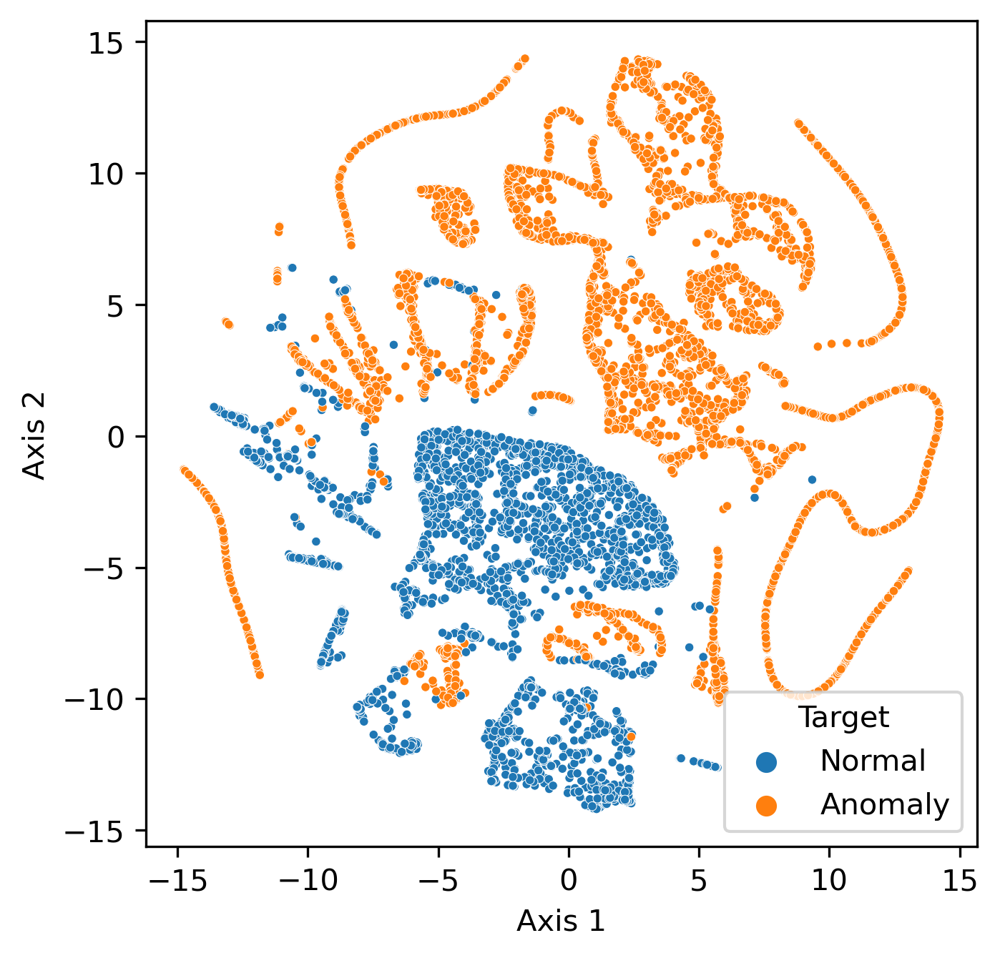

In [749]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


tar=sdnTarget["Label"]
fe=sdnFeature

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(fe)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))



fe['Axis 1'] = tsne_results[:,0]
fe['Axis 2'] = tsne_results[:,1]
tar.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
plt.rcParams.update(plt.rcParamsDefault)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=tar,
    data=fe,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=9
)
plt.savefig('SDNscatter.pdf')
plt.savefig('SDNscatter.png')

ETC


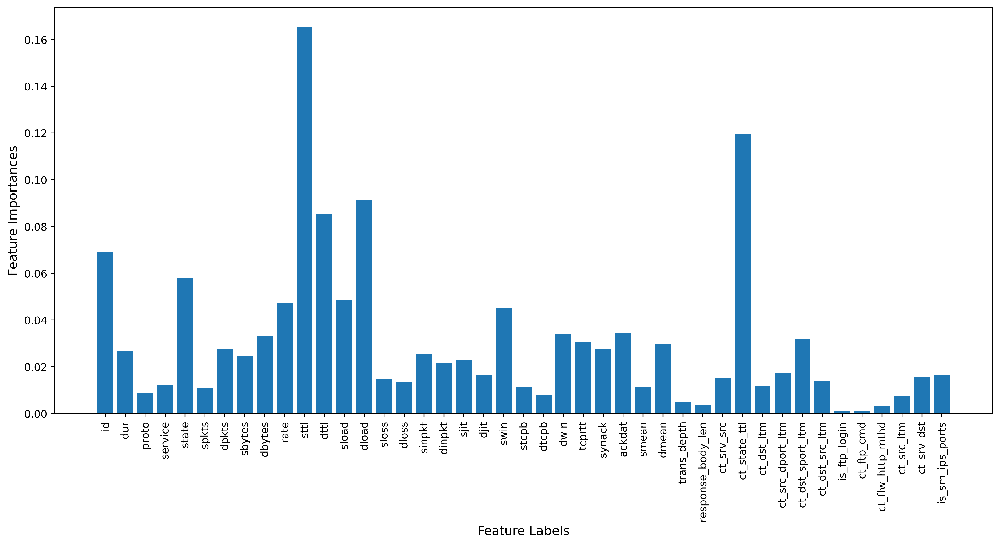

In [33]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=30)

X =dataFFeatures

y =  DataFTarget["Label"]
# Training the model
dt.fit(X, y)

# Computing the importance of each feature
feature_importance = dt.feature_importances_

# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
plt.figure(figsize=(13,7),dpi=400)
plt.xticks(rotation=90)
# Plotting a Bar Graph to compare the models
plt.bar(X.columns, feature_importance_normalized)
plt.xlabel('Feature Labels',fontsize=12)
plt.ylabel('Feature Importances',fontsize=12)


plt.tight_layout(pad=0)
plt.savefig('UNSWFeature.pdf')
plt.show()

In [34]:
featuresimpF=[]
for i in range (len(X.columns)):
    if feature_importance_normalized[i]>0.02:
        featuresimpF.append(X.columns[i])
len(featuresimpF)        

22

ETC


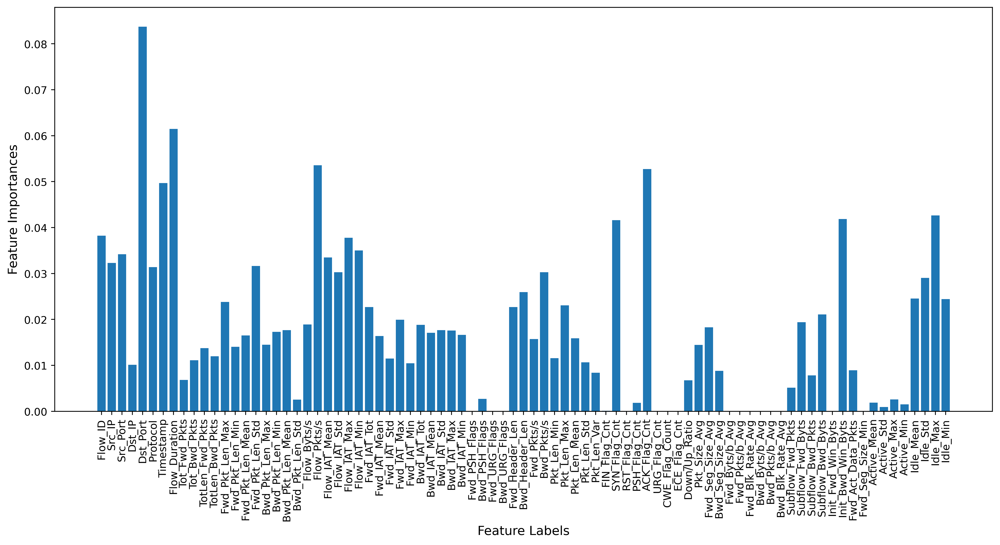

In [35]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=30)

X =dataIFeatures

y =  DataITarget["Label"]
# Training the model
dt.fit(X, y)

# Computing the importance of each feature
feature_importance = dt.feature_importances_

# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
plt.figure(figsize=(13,7),dpi=400)
plt.xticks(rotation=90)
# Plotting a Bar Graph to compare the models
plt.bar(X.columns, feature_importance_normalized)
plt.xlabel('Feature Labels',fontsize=12)
plt.ylabel('Feature Importances',fontsize=12)


plt.tight_layout(pad=0)
plt.savefig('IoTFeature.pdf')
plt.show()

In [36]:
featuresimp=[]
for i in range (len(X.columns)):
    if feature_importance_normalized[i]>0.02:
        featuresimp.append(X.columns[i])
len(featuresimp)       

27

In [37]:
sdnFeature

,Flow ID,Src IP,Src Port,Dst IP,Dst Port,Protocol,Timestamp,Flow Duration,Tot Fwd Pkts,Tot Bwd Pkts,...,Fwd Act Data Pkts,Fwd Seg Size Min,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min
53132,3528,1024,3550,117,16,2,342,1627,1,2,...,1,0,0,0,0,0,0,0,0,0
31435,4859,2155,5,115,1384,1,243,306,2,1,...,1,0,0,0,0,0,0,0,0,0
20861,4751,2142,5,115,1361,1,623,1,1,0,...,0,0,0,0,0,0,0,0,0,0
138004,8293,1119,4536,116,19,1,132,123,2,0,...,0,0,0,0,0,0,0,0,0,0
34807,751,1024,1612,79,61,1,257,5400,6,4,...,3,0,146,0,135,319,85,0,83,130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143324,7495,1025,2,132,1238,1,107,1937,0,2,...,0,0,0,0,0,0,0,0,0,0
168200,6490,1119,962,116,19,1,84,983,2,4,...,1,0,0,0,0,0,0,0,0,0
72540,9451,2313,0,116,0,0,227,0,0,1,...,0,0,0,0,0,0,0,0,0,0
190005,3926,1119,855,115,153,1,39,3172,0,1,...,0,0,0,0,0,0,0,0,0,0


ETC


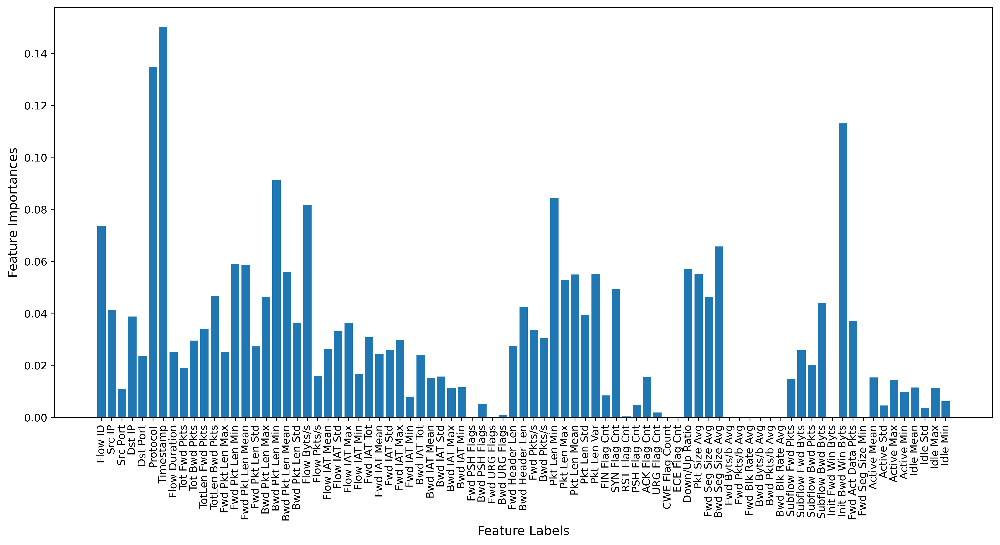

In [38]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=30)

X =sdnFeature

y =sdnTarget["Label"]
# Training the model
dt.fit(X, y)

# Computing the importance of each feature
feature_importance = dt.feature_importances_

# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
plt.figure(figsize=(13,7),dpi=400)
plt.xticks(rotation=90)
# Plotting a Bar Graph to compare the models
plt.bar(X.columns, feature_importance_normalized)
plt.xlabel('Feature Labels',fontsize=12)
plt.ylabel('Feature Importances',fontsize=12)


plt.tight_layout(pad=0)
plt.savefig('SDNFeature.pdf')
plt.show()

In [39]:
featuresimpS=[]
for i in range (len(X.columns)):
    if feature_importance_normalized[i]>0.0001:
        featuresimpS.append(X.columns[i])
len(featuresimpS)       

71

In [40]:
dataIFeatures= dataIFeatures[featuresimp[:20]]

In [41]:
dataFFeatures= dataFFeatures[featuresimpF[:20]]

In [42]:
sdnFeature= sdnFeature[featuresimpS[:20]]

In [43]:
len(dataIFeatures)

10000

In [44]:
len(dataFFeatures)

10000

In [45]:
len(sdnFeature)

10000

In [46]:
a=[]
for i in range(20):
    a.append(i)

In [47]:
dataIFeatures.columns=a
dataFFeatures.columns=a
sdnFeature.columns=a

In [48]:
newfeatures=dataFFeatures.append(dataIFeatures,ignore_index = True)
newfeatures=newfeatures.append(sdnFeature,ignore_index = True)
newtarget=DataFTarget["Label"].append(DataITarget["Label"],ignore_index = True)
newtarget=newtarget.append(sdnTarget["Label"],ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_16748\2730315564.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  newfeatures=dataFFeatures.append(dataIFeatures,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_16748\2730315564.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  newfeatures=newfeatures.append(sdnFeature,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_16748\2730315564.py:3: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  newtarget=DataFTarget["Label"].append(DataITarget["Label"],ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_16748\2730315564.py:4: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pand

In [51]:
newfeatures.to_csv('IOTUNSWSDNMulti.csv')

In [49]:
newfeatures['target']=newtarget
Data25=newfeatures
dataF9=Data25.loc[Data25['target'] == "Normal"]
print(len(dataF9))
dataF10=Data25.loc[Data25['target'] == "Anomaly"]
print(len(dataF10))

7485
22515


In [841]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
ScDATA=scaler.fit_transform(newfeatures)


In [623]:
from sklearn.preprocessing import FunctionTransformer
import numpy as np

transformer = FunctionTransformer(np.log1p)
ScDATA = transformer.transform(newfeatures)

In [842]:
newfeatures=pd.DataFrame(ScDATA)

In [843]:
newfeatures

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0.909837,0.001709,0.000672,0.000000,0.023782,0.000000,0.998487,0.001147,0.000000,0.955208,0.000000,0.001748,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001929
1,0.511701,0.465730,0.000448,0.012862,0.100928,0.016334,0.365872,0.001147,0.018797,0.296329,0.203354,0.550592,0.690730,0.001524,0.001468,0.667823,0.799352,0.444098,0.004296,0.000964
2,0.942762,0.922537,0.000448,0.041801,0.393852,0.745009,0.088914,0.001147,0.018797,0.194801,0.579992,0.913575,0.888680,0.001524,0.001468,0.784909,0.597230,0.883214,0.311856,0.000964
3,0.616756,0.516803,0.000448,0.012862,0.401392,0.016334,0.290011,0.001147,0.018797,0.534340,0.158443,0.619149,0.775895,0.001524,0.001468,0.631396,0.675604,0.564310,0.004296,0.000964
4,0.455070,0.939054,0.000448,0.045016,0.276682,0.351180,0.093265,0.000656,0.018797,0.054102,0.193716,0.885997,0.922996,0.001524,0.001468,0.937843,0.903359,0.940206,0.030928,0.000964
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,0.804376,0.217771,0.886949,0.299035,0.011021,0.000907,0.022512,0.710914,0.007519,0.000878,0.024672,0.081569,0.032434,0.000000,0.411894,0.188494,0.103712,0.000000,0.564433,0.607522
29996,0.185695,0.217771,0.999105,0.292605,0.077726,0.000907,0.006432,0.192232,0.000000,0.000176,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
29997,0.079627,0.196317,0.523842,0.199357,0.036543,0.000907,0.054673,0.862176,0.022556,0.000703,0.051079,0.003884,0.057334,0.000000,0.286344,0.160162,0.008544,0.000000,0.034364,0.074253
29998,0.233310,0.196317,0.327065,0.070740,0.036543,0.000907,0.077753,0.958538,0.428571,0.021430,0.136276,0.165081,0.046662,0.000000,0.065345,0.019370,0.152328,0.000000,0.817010,0.971070


In [844]:
from collections import Counter
Counter(newtarget)

Counter({'Anomaly': 22559, 'Normal': 7441})

In [845]:
newfeatures['target']=newtarget

In [846]:
newfeatures=newfeatures.sample(frac=1)

In [847]:
len(newfeatures)

30000

In [848]:
Data25=newfeatures
dataF9=Data25.loc[Data25['target'] == "Normal"]
print(len(dataF9))
dataF10=Data25.loc[Data25['target'] == "Anomaly"]
print(len(dataF10))

7441
22559


Data25.to_csv('MENImblanced.csv')

In [849]:
dataF9.columns = dataF9.columns.astype(str)
dataF10.columns = dataF10.columns.astype(str)

In [851]:
dataF9['target'] = dataF9['target'].map({'Normal':0})
dataF9

C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\1141975889.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataF9['target'] = dataF9['target'].map({'Normal':0})


,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
3950,0.601054,0.455667,0.000448,0.019293,0.067865,0.020871,0.440219,0.001147,0.018797,0.251361,...,0.534667,0.560996,0.001524,0.001468,0.369182,0.417207,0.216755,0.003436,0.000964,0
23803,0.452234,0.196317,0.016342,0.594855,0.036543,0.000907,0.044646,0.886267,0.037594,0.002108,...,0.136143,0.077841,0.000000,0.591043,0.245736,0.137890,0.000000,0.723368,0.878496,0
796,0.552528,0.705715,0.000448,0.028939,0.167053,0.067151,0.349603,0.001147,0.018797,0.233796,...,0.598369,0.661645,0.001524,0.001468,0.442903,0.381261,0.537216,0.014605,0.000964,0
27749,0.460642,0.196317,0.055071,0.717042,0.036543,0.000907,0.061672,0.870698,0.033835,0.001757,...,0.062148,0.057334,0.000000,0.367107,0.165944,0.046847,0.000000,0.160653,0.207329,0
9094,0.355384,0.515094,0.000448,0.019293,0.147332,0.199637,0.356602,0.000656,0.018797,0.326717,...,0.617790,0.658715,0.001524,0.001468,0.307025,0.253094,0.435378,0.081615,0.000964,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20930,0.103130,0.196317,0.038728,0.205788,0.036543,0.000907,0.043700,0.867584,0.030075,0.001054,...,0.008545,0.057334,0.000000,0.222467,0.130674,0.008544,0.000000,0.071306,0.083896,0
26496,0.283051,0.196317,0.369375,0.302251,0.009281,0.001815,0.045214,0.316618,0.003759,0.000351,...,0.048942,0.002511,0.006860,0.088106,0.000000,0.040071,0.002803,0.457904,0.282546,0
23553,0.080742,0.178849,0.001343,0.295820,0.723898,0.000907,0.057132,0.586037,0.007519,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0
7986,0.570965,0.366622,0.000448,0.012862,0.055104,0.016334,0.510405,0.001147,0.018797,0.326366,...,0.429210,0.505127,0.001524,0.001468,0.476149,0.555981,0.372158,0.004296,0.000964,0


In [852]:
def dimRed(df):
    from sklearn.decomposition import PCA
    from sklearn.manifold import TSNE
    #replace the lable with 1
    Mini=df
    i=0
    features=df.drop('target',axis=1)
    target=df['target']
    #find distance
    svd = PCA(n_components=2)
    #prepare transform on dataset
    svd.fit(features)
    pca_result = svd.transform(features)
    df['pca-one'] = pca_result[:,0]
    df['pca-two'] = pca_result[:,1] 
    #create datafram of distance
    Z=df[['pca-one','pca-two']]
    Z['target']=target
    #create dumy dataframe of original values
    Mini=Mini.drop(['pca-one','pca-two'], axis=1)
    #Z=X.loc[X['attack_cat'] == 1]
    Z=Z.reset_index()
    Mini=Mini.reset_index()
    Mini=Mini.drop('index', axis=1)
    print(Z.shape)
    print(Mini.shape)
    return Z, Mini


In [853]:
dataF9

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
3950,0.601054,0.455667,0.000448,0.019293,0.067865,0.020871,0.440219,0.001147,0.018797,0.251361,...,0.534667,0.560996,0.001524,0.001468,0.369182,0.417207,0.216755,0.003436,0.000964,0
23803,0.452234,0.196317,0.016342,0.594855,0.036543,0.000907,0.044646,0.886267,0.037594,0.002108,...,0.136143,0.077841,0.000000,0.591043,0.245736,0.137890,0.000000,0.723368,0.878496,0
796,0.552528,0.705715,0.000448,0.028939,0.167053,0.067151,0.349603,0.001147,0.018797,0.233796,...,0.598369,0.661645,0.001524,0.001468,0.442903,0.381261,0.537216,0.014605,0.000964,0
27749,0.460642,0.196317,0.055071,0.717042,0.036543,0.000907,0.061672,0.870698,0.033835,0.001757,...,0.062148,0.057334,0.000000,0.367107,0.165944,0.046847,0.000000,0.160653,0.207329,0
9094,0.355384,0.515094,0.000448,0.019293,0.147332,0.199637,0.356602,0.000656,0.018797,0.326717,...,0.617790,0.658715,0.001524,0.001468,0.307025,0.253094,0.435378,0.081615,0.000964,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20930,0.103130,0.196317,0.038728,0.205788,0.036543,0.000907,0.043700,0.867584,0.030075,0.001054,...,0.008545,0.057334,0.000000,0.222467,0.130674,0.008544,0.000000,0.071306,0.083896,0
26496,0.283051,0.196317,0.369375,0.302251,0.009281,0.001815,0.045214,0.316618,0.003759,0.000351,...,0.048942,0.002511,0.006860,0.088106,0.000000,0.040071,0.002803,0.457904,0.282546,0
23553,0.080742,0.178849,0.001343,0.295820,0.723898,0.000907,0.057132,0.586037,0.007519,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0
7986,0.570965,0.366622,0.000448,0.012862,0.055104,0.016334,0.510405,0.001147,0.018797,0.326366,...,0.429210,0.505127,0.001524,0.001468,0.476149,0.555981,0.372158,0.004296,0.000964,0


In [854]:
import random


In [855]:
Z, Mini=dimRed(dataF9)

import random
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics.pairwise import pairwise_distances
arr=[]
import math
import statistics
# l will suppot to generate data more than its acutal lenght
l=0
for i in range(1):
    print(i)
    if(l<len(dataF9)):    
        print(dataF9.shape)
        print(Z.shape)
        print(Mini.shape)
        print(l)
        Z['distance']=0
        Z['distance']=pairwise_distances(Z[i:i+1],Z[:]).reshape(-1)
        #distance measure
        #for j in range(len(Z)):
           # Z['distance'][j]=math.dist([Z['pca-one'][l], Z['pca-one'][l]],[Z['pca-two'][j], Z['pca-two'][j]])
        #get the points and to measure the smilarlty
        #P1=Mini.iloc[Z['distance'][l:].idxmin(),l]
        #P2=Mini.iloc[l]
        a=[]
        #for k in range(len(P1)):
            #a.append(statistics.mean([P1[k],P2[k]]))
        #    a.append((P1[k]+P2[k])/2)
        a=Mini.iloc[[Z['distance'][l+1:].idxmin(),Z['distance'][l+1:].nsmallest(2).index[1],l]].mean(axis=0)
        #num1=random.uniform(0.1, 1)
        #a1=a*num1
        arr.append(a)
        l=l+1

    else:
        Genrated=pd.DataFrame(arr)
        print(Genrated)
        new_header = Mini.columns #grab the first row for the header
        Genrated.columns = new_header #set the header row as the df header
        Genrated['target']=Genrated['target']
        dataF9=dataF9.drop(['pca-one','pca-two'], axis=1)
        dataF9=Genrated.append(dataF9,ignore_index = True)
        #print(dataF9)
        print(dataF9.shape)
        Z, Mini=dimRed(dataF9)
        dataF9=dataF9.reset_index()
        dataF9=dataF9.drop('index',axis=1)
        arr.clear()
        l=0
        
Genrated=pd.DataFrame(arr)
new_header = Mini.columns #grab the first row for the header
Genrated.columns = new_header #set the header row as the df header
Genrated['target']=Genrated['target'].astype(int)
dataF9=dataF9.drop(['pca-one','pca-two'], axis=1)
dataF9=Genrated.append(dataF9,ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\3994028085.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['pca-one'] = pca_result[:,0]
C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\3994028085.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['pca-two'] = pca_result[:,1]
C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\3994028085.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

(7441, 4)
(7441, 21)
0
(7441, 23)
(7441, 4)
(7441, 21)
0


C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\1417935457.py:57: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF9=Genrated.append(dataF9,ignore_index = True)


In [857]:
Genrated

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,0.26279,0.251123,0.000373,0.036442,0.176141,0.288264,0.665973,0.000601,0.008772,0.574331,...,0.309704,0.284509,0.001016,0.000979,0.12653,0.142605,0.073913,0.11827,0.000321,0


In [858]:
dataF9

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,0.262790,0.251123,0.000373,0.036442,0.176141,0.288264,0.665973,0.000601,0.008772,0.574331,...,0.309704,0.284509,0.001016,0.000979,0.126530,0.142605,0.073913,0.118270,0.000321,0
1,0.601054,0.455667,0.000448,0.019293,0.067865,0.020871,0.440219,0.001147,0.018797,0.251361,...,0.534667,0.560996,0.001524,0.001468,0.369182,0.417207,0.216755,0.003436,0.000964,0
2,0.452234,0.196317,0.016342,0.594855,0.036543,0.000907,0.044646,0.886267,0.037594,0.002108,...,0.136143,0.077841,0.000000,0.591043,0.245736,0.137890,0.000000,0.723368,0.878496,0
3,0.552528,0.705715,0.000448,0.028939,0.167053,0.067151,0.349603,0.001147,0.018797,0.233796,...,0.598369,0.661645,0.001524,0.001468,0.442903,0.381261,0.537216,0.014605,0.000964,0
4,0.460642,0.196317,0.055071,0.717042,0.036543,0.000907,0.061672,0.870698,0.033835,0.001757,...,0.062148,0.057334,0.000000,0.367107,0.165944,0.046847,0.000000,0.160653,0.207329,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7437,0.103130,0.196317,0.038728,0.205788,0.036543,0.000907,0.043700,0.867584,0.030075,0.001054,...,0.008545,0.057334,0.000000,0.222467,0.130674,0.008544,0.000000,0.071306,0.083896,0
7438,0.283051,0.196317,0.369375,0.302251,0.009281,0.001815,0.045214,0.316618,0.003759,0.000351,...,0.048942,0.002511,0.006860,0.088106,0.000000,0.040071,0.002803,0.457904,0.282546,0
7439,0.080742,0.178849,0.001343,0.295820,0.723898,0.000907,0.057132,0.586037,0.007519,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0
7440,0.570965,0.366622,0.000448,0.012862,0.055104,0.016334,0.510405,0.001147,0.018797,0.326366,...,0.429210,0.505127,0.001524,0.001468,0.476149,0.555981,0.372158,0.004296,0.000964,0


In [639]:
dataF9['target'] = dataF9['target'].map({0:'Normal'})

In [762]:
Genrated

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,6.563383,6.377687,7.040017,4.256206,1.704812,5.154476,5.758595,4.561182,1.564284,3.276670,...,5.631456,3.725698,3.782798,4.336559,2.342720,1.747598,1.066019,2.903965,2.464530,Normal
1,7.843670,7.641377,0.693147,2.685739,6.220286,5.363684,7.917887,1.566501,0.937283,7.876243,...,7.443381,7.424597,7.530147,0.693147,1.098612,5.054161,4.941832,4.357963,4.033533,Normal
2,7.713088,7.692665,0.693147,3.047750,6.707398,5.786969,7.936379,1.476398,0.815215,8.153924,...,7.297845,7.285981,7.483024,0.693147,1.098612,4.740425,4.618111,4.002776,4.352751,Normal
3,7.200275,6.656028,6.630194,4.192261,3.065507,3.028223,5.774109,5.146800,1.307335,1.746624,...,4.570615,4.114495,2.607239,4.344353,2.189212,2.938118,1.769123,3.974659,2.780714,Normal
4,7.500657,4.501258,2.904277,1.292691,2.824475,2.896487,5.866754,1.453543,0.835280,5.266189,...,5.387244,2.539991,1.792024,1.445057,1.028919,0.632262,0.605671,0.606147,1.425620,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7895,7.778503,6.933098,5.590604,4.756252,4.296726,1.098612,5.989048,7.492182,0.693147,0.732408,...,4.735269,3.065752,2.580801,5.297276,0.000000,4.695876,2.610671,6.196568,3.874584,Normal
7896,7.658881,5.369540,3.178921,3.061469,3.525987,2.670562,6.683688,4.793304,0.366204,4.668587,...,3.118147,0.000000,2.015002,1.990421,0.000000,0.000000,0.000000,0.597253,0.597253,Normal
7897,8.116360,7.436823,0.693147,2.524168,6.153286,5.508626,8.090673,1.656604,1.059351,7.929618,...,7.331744,7.301113,7.337378,0.693147,1.098612,5.782150,5.838209,4.451753,3.595476,Normal
7898,7.599252,6.399115,0.462098,2.118703,5.817042,4.930984,8.356757,1.386294,0.693147,8.421009,...,6.735287,6.707458,6.008134,0.462098,0.732408,3.365926,3.315946,2.413550,3.837802,Normal


In [641]:
Real=Data25.loc[Data25['target'] == "Normal"]
Genrated['target'] = Genrated['target'].map({0:'Normal'})

In [642]:
dataF=dataF9.append(dataF10,ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_42012\1761473857.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataF9.append(dataF10,ignore_index = True)


In [643]:
print(Counter(dataF['target']))

Counter({'Normal': 22450, 'Anomaly': 22450})


In [644]:
dataF

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,6.563383,6.377687,7.040017,4.256206,1.704812,5.154476,5.758595,4.561182,1.564284,3.276670,...,5.631456,3.725698,3.782798,4.336559,2.342720,1.747598,1.066019,2.903965,2.464530,Normal
1,7.843670,7.641377,0.693147,2.685739,6.220286,5.363684,7.917887,1.566501,0.937283,7.876243,...,7.443381,7.424597,7.530147,0.693147,1.098612,5.054161,4.941832,4.357963,4.033533,Normal
2,7.713088,7.692665,0.693147,3.047750,6.707398,5.786969,7.936379,1.476398,0.815215,8.153924,...,7.297845,7.285981,7.483024,0.693147,1.098612,4.740425,4.618111,4.002776,4.352751,Normal
3,7.200275,6.656028,6.630194,4.192261,3.065507,3.028223,5.774109,5.146800,1.307335,1.746624,...,4.570615,4.114495,2.607239,4.344353,2.189212,2.938118,1.769123,3.974659,2.780714,Normal
4,7.500657,4.501258,2.904277,1.292691,2.824475,2.896487,5.866754,1.453543,0.835280,5.266189,...,5.387244,2.539991,1.792024,1.445057,1.028919,0.632262,0.605671,0.606147,1.425620,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44895,8.954544,7.828436,0.693147,1.791759,5.484797,5.634790,7.682943,1.791759,1.791759,7.592366,...,7.994295,8.011355,8.100161,0.693147,1.098612,6.458338,6.200509,6.820016,4.770685,Anomaly
44896,7.533694,6.111467,7.109879,1.386294,0.693147,7.575072,4.290459,0.000000,0.000000,0.000000,...,6.338594,0.000000,4.234107,4.060443,0.000000,0.000000,0.000000,1.791759,1.791759,Anomaly
44897,8.298042,1.609438,1.098612,0.000000,2.708050,0.000000,8.576782,2.197225,0.000000,8.609225,...,1.609438,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,Anomaly
44898,8.806124,7.785305,0.693147,1.791759,4.682131,3.218876,7.746301,2.197225,1.791759,7.192182,...,7.937732,7.953318,8.081166,0.693147,1.098612,6.948897,6.670766,7.349874,1.791759,Anomaly


dataF.to_csv("SDNProposedUpsamplingData1.csv")

In [13]:
dataF=pd.read_csv('SDNProposedUpsamplingData1.csv')

In [528]:
target=Data25['target']
feature=Data25.drop('target',axis=1)

In [529]:
feature.shape

(30000, 20)

In [754]:
Counter(target)

Counter({'Anomaly': 22450, 'Normal': 7550})

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 30000 samples in 0.001s...
[t-SNE] Computed neighbors for 30000 samples in 14.840s...
[t-SNE] Computed conditional probabilities for sample 1000 / 30000
[t-SNE] Computed conditional probabilities for sample 2000 / 30000
[t-SNE] Computed conditional probabilities for sample 3000 / 30000
[t-SNE] Computed conditional probabilities for sample 4000 / 30000
[t-SNE] Computed conditional probabilities for sample 5000 / 30000
[t-SNE] Computed conditional probabilities for sample 6000 / 30000
[t-SNE] Computed conditional probabilities for sample 7000 / 30000
[t-SNE] Computed conditional probabilities for sample 8000 / 30000
[t-SNE] Computed conditional probabilities for sample 9000 / 30000
[t-SNE] Computed conditional probabilities for sample 10000 / 30000
[t-SNE] Computed conditional probabilities for sample 11000 / 30000
[t-SNE] Computed conditional probabilities for sample 12000 / 30000
[t-SNE] Computed conditional probabilities for s

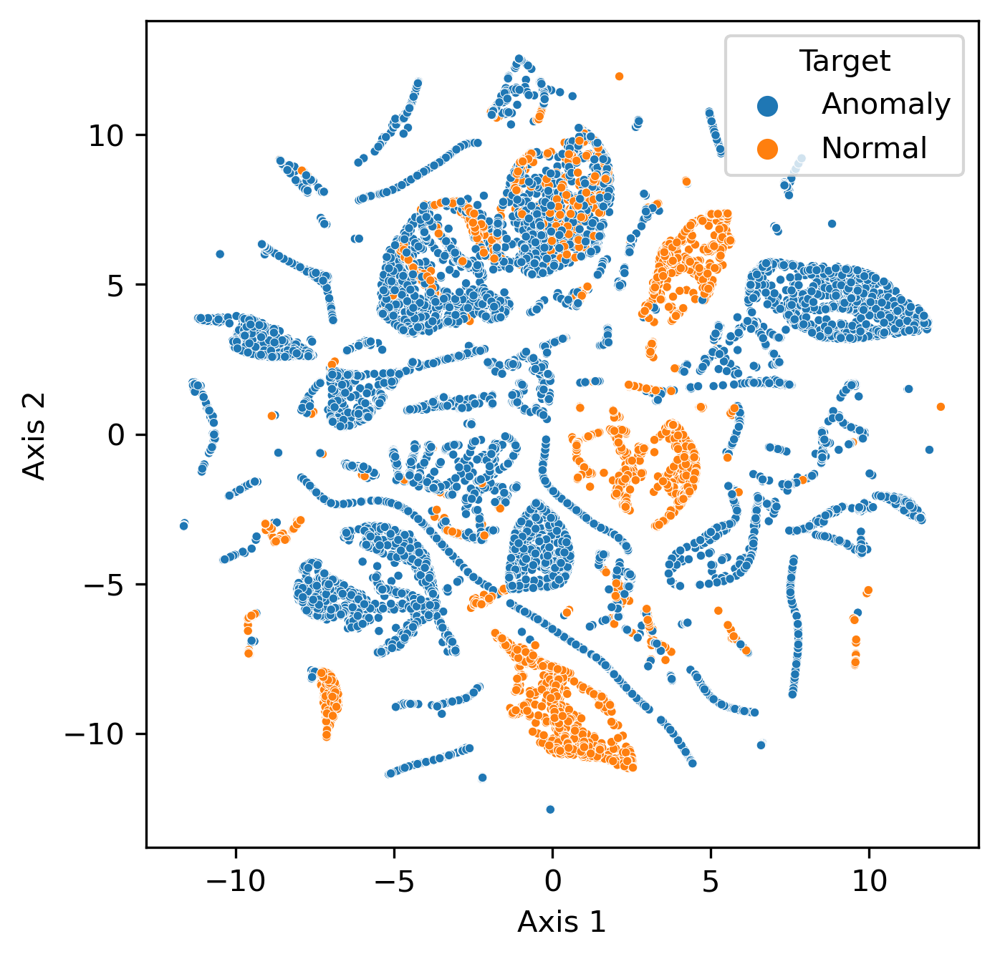

In [755]:
tar=Data25['target']
fe=Data25.drop('target',axis=1)
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(fe)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))



fe['Axis 1'] = tsne_results[:,0]
fe['Axis 2'] = tsne_results[:,1]
tar.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
plt.rcParams.update(plt.rcParamsDefault)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=tar,
    data=fe,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=9
)
plt.savefig('MENImbalanced.pdf')
plt.savefig('MENImbalanced.png')

# Original

In [530]:
X_train, X_test, y_train, y_test = train_test_split(feature, target, test_size=0.30, random_state=1, stratify=target, shuffle=True)
    

In [448]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=100, random_state=2,max_depth=10) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9725555555555555
              precision    recall  f1-score   support

     Anomaly       0.97      0.99      0.98      6735
      Normal       0.98      0.91      0.94      2265

    accuracy                           0.97      9000
   macro avg       0.98      0.95      0.96      9000
weighted avg       0.97      0.97      0.97      9000

[[6695   40]
 [ 207 2058]]
0.9725555555555555


In [449]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.2)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))
a=accuracy_score(y_test,xgb_pred)
print(a)

ADA
              precision    recall  f1-score   support

     Anomaly       0.95      0.98      0.97      6735
      Normal       0.95      0.84      0.89      2265

    accuracy                           0.95      9000
   macro avg       0.95      0.91      0.93      9000
weighted avg       0.95      0.95      0.95      9000

[[6630  105]
 [ 365 1900]]
0.9477777777777778


In [450]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=100, random_state=5, max_depth=10)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))
a=accuracy_score(y_test,b_pred)
print(a)

ETC
              precision    recall  f1-score   support

     Anomaly       0.94      1.00      0.97      6735
      Normal       1.00      0.82      0.90      2265

    accuracy                           0.95      9000
   macro avg       0.97      0.91      0.94      9000
weighted avg       0.96      0.95      0.95      9000

[[6733    2]
 [ 408 1857]]
0.9544444444444444


In [451]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='saga',multi_class='multinomial',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))
a=accuracy_score(y_test,y_pred_class)
print(a)

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


              precision    recall  f1-score   support

     Anomaly       0.90      0.96      0.93      6735
      Normal       0.86      0.69      0.77      2265

    accuracy                           0.89      9000
   macro avg       0.88      0.83      0.85      9000
weighted avg       0.89      0.89      0.89      9000

[[6486  249]
 [ 701 1564]]
0.8944444444444445


In [540]:
from keras.models import Sequential
# from tensorflow.keras.utils import to_categorical
from keras.layers import Dense, LSTM,Embedding,Bidirectional,Dropout
model = Sequential()
# model.add(Embedding(voc_size, embed_size, weights=[embedding_matrix]))
model.add(Embedding(1000,100, input_length=X_train.shape[1]))
model.add(LSTM(128))
model.add(Dropout(0.5))
model.add(Dense(64,activation='relu'))
model.add(Dense(32,activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(loss = 'binary_crossentropy',optimizer = 'adam' ,metrics=['accuracy'])
print(model.summary())

Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_36 (Embedding)    (None, 20, 100)           100000    
                                                                 
 lstm_82 (LSTM)              (None, 128)               117248    
                                                                 
 dropout_37 (Dropout)        (None, 128)               0         
                                                                 
 dense_142 (Dense)           (None, 64)                8256      
                                                                 
 dense_143 (Dense)           (None, 32)                2080      
                                                                 
 dense_144 (Dense)           (None, 2)                 66        
                                                                 
Total params: 227,650
Trainable params: 227,650
Non-t

In [541]:
y_train1 = pd.get_dummies(y_train).values
y_test1= pd.get_dummies(y_test).values

historyLSTMO=model.fit(X_train,y_train1, validation_split=0.1, epochs=50)
import numpy as np
# ----- Evaluate model -----
#probabilities = model.predict(x_test)
#pred = np.argmax(probabilities, axis=1)

print("Results")

#print(classification_report(y_test, probabilities.round()))
#cf_matrix=confusion_matrix(y_test, probabilities.round())
#cf_matrix

predict_x=model.predict(X_test) 
classes_x=np.argmax(predict_x,axis=1)
rounded_labels=np.argmax(y_test1, axis=1)
print(classification_report(rounded_labels,classes_x))
print(confusion_matrix(rounded_labels,classes_x))

Epoch 1/50
591/591 [==============================] - 24s 36ms/step - loss: 0.3089 - accuracy: 0.8742 - val_loss: 0.2140 - val_accuracy: 0.9062
Epoch 2/50
591/591 [==============================] - 20s 34ms/step - loss: 0.1814 - accuracy: 0.9251 - val_loss: 0.1340 - val_accuracy: 0.9405
Epoch 3/50
591/591 [==============================] - 19s 33ms/step - loss: 0.1397 - accuracy: 0.9418 - val_loss: 0.1205 - val_accuracy: 0.9443
Epoch 4/50
591/591 [==============================] - 23s 39ms/step - loss: 0.1209 - accuracy: 0.9476 - val_loss: 0.1134 - val_accuracy: 0.9414
Epoch 5/50
591/591 [==============================] - 27s 45ms/step - loss: 0.1103 - accuracy: 0.9504 - val_loss: 0.1096 - val_accuracy: 0.9467
Epoch 6/50
591/591 [==============================] - 22s 37ms/step - loss: 0.1000 - accuracy: 0.9530 - val_loss: 0.0991 - val_accuracy: 0.9538
Epoch 7/50
591/591 [==============================] - 19s 32ms/step - loss: 0.0949 - accuracy: 0.9543 - val_loss: 0.0961 - val_accuracy:

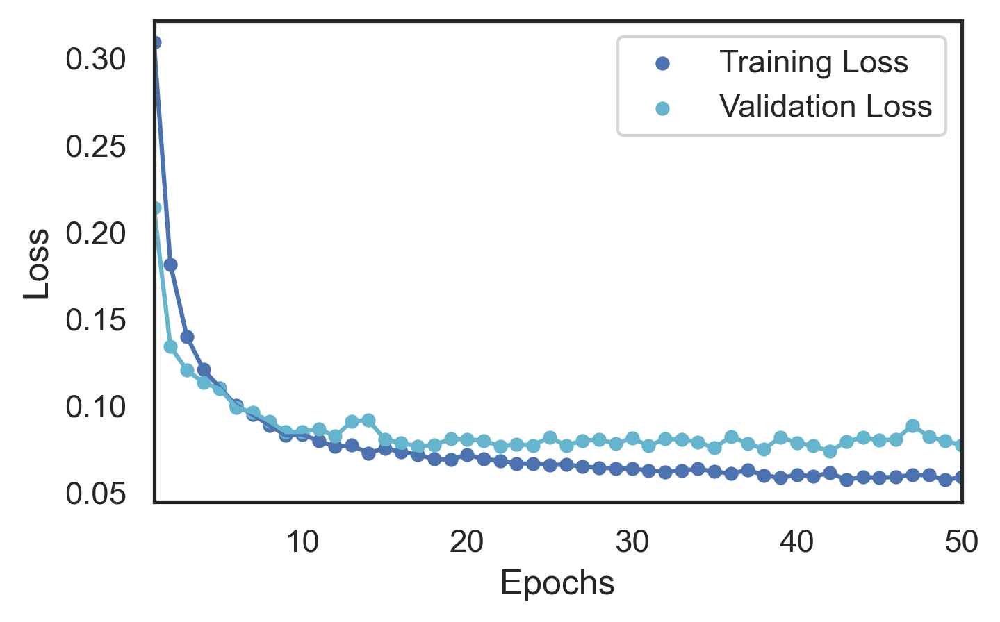

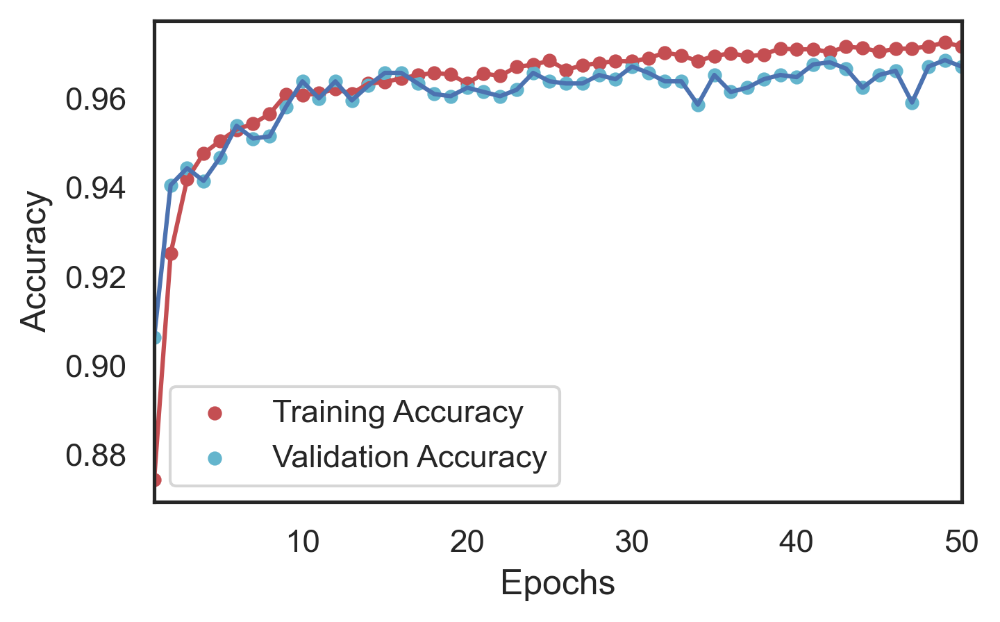

In [599]:

# Assuming you have the epochs results in 'loss_values' and 'accuracy_values' variables
plot_epochs_results(historyLSTMO.history['loss'],
                    historyLSTMO.history['val_loss'],
                    historyLSTMO.history['accuracy'],
                    historyLSTMO.history['val_accuracy'],'LSTMOriginal')


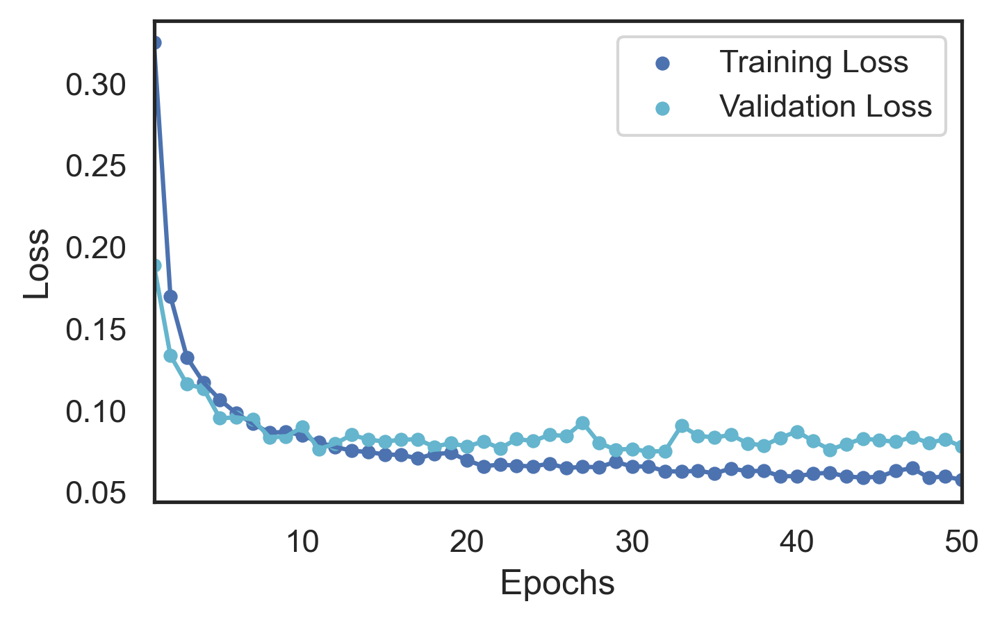

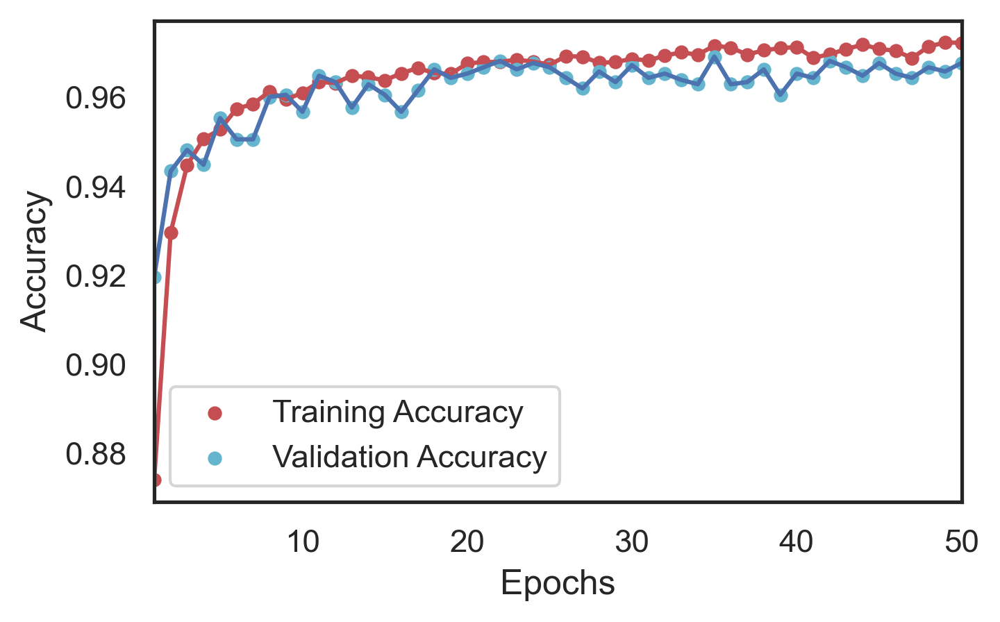

In [598]:



# Assuming you have the epochs results in 'loss_values' and 'accuracy_values' variables
plot_epochs_results(historyGRUO.history['loss'],
                    historyGRUO.history['val_loss'],
                    historyGRUO.history['accuracy'],historyGRUO.history['val_accuracy'],'GRUOriginal')


In [542]:
from keras.models import Sequential
# from tensorflow.keras.utils import to_categorical
from keras.layers import Dense, LSTM,Embedding,Bidirectional,Dropout
model = Sequential()
# model.add(Embedding(voc_size, embed_size, weights=[embedding_matrix]))
model.add(Embedding(1000,100, input_length=X_train.shape[1]))
model.add(Conv1D(128, 3, activation='relu'))
model.add(MaxPooling1D(pool_size=3))
model.add(Activation('relu'))
model.add(Dropout(rate=0.5))
model.add(Flatten())
model.add(Dense(32,activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(loss = 'binary_crossentropy',optimizer = 'adam' ,metrics=['accuracy'])
print(model.summary())

Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_37 (Embedding)    (None, 20, 100)           100000    
                                                                 
 conv1d_1 (Conv1D)           (None, 18, 128)           38528     
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 6, 128)           0         
 1D)                                                             
                                                                 
 activation_14 (Activation)  (None, 6, 128)            0         
                                                                 
 dropout_38 (Dropout)        (None, 6, 128)            0         
                                                                 
 flatten_11 (Flatten)        (None, 768)               0         
                                                     

In [543]:
y_train1 = pd.get_dummies(y_train).values
y_test1= pd.get_dummies(y_test).values

historyCNNO=model.fit(X_train,y_train1, validation_split=0.1, epochs=50)
import numpy as np
# ----- Evaluate model -----
#probabilities = model.predict(x_test)
#pred = np.argmax(probabilities, axis=1)

print("Results")

#print(classification_report(y_test, probabilities.round()))
#cf_matrix=confusion_matrix(y_test, probabilities.round())
#cf_matrix

predict_x=model.predict(X_test) 
classes_x=np.argmax(predict_x,axis=1)
rounded_labels=np.argmax(y_test1, axis=1)
print(classification_report(rounded_labels,classes_x))
print(confusion_matrix(rounded_labels,classes_x))

Epoch 1/50
591/591 [==============================] - 6s 9ms/step - loss: 0.1968 - accuracy: 0.9173 - val_loss: 0.1107 - val_accuracy: 0.9552
Epoch 2/50
591/591 [==============================] - 5s 8ms/step - loss: 0.1220 - accuracy: 0.9499 - val_loss: 0.0995 - val_accuracy: 0.9538
Epoch 3/50
591/591 [==============================] - 5s 8ms/step - loss: 0.1088 - accuracy: 0.9539 - val_loss: 0.0911 - val_accuracy: 0.9595
Epoch 4/50
591/591 [==============================] - 5s 8ms/step - loss: 0.1017 - accuracy: 0.9566 - val_loss: 0.0927 - val_accuracy: 0.9600
Epoch 5/50
591/591 [==============================] - 5s 8ms/step - loss: 0.0967 - accuracy: 0.9557 - val_loss: 0.0850 - val_accuracy: 0.9619
Epoch 6/50
591/591 [==============================] - 5s 8ms/step - loss: 0.0913 - accuracy: 0.9593 - val_loss: 0.0818 - val_accuracy: 0.9576
Epoch 7/50
591/591 [==============================] - 5s 8ms/step - loss: 0.0893 - accuracy: 0.9588 - val_loss: 0.0806 - val_accuracy: 0.9581
Epoch 

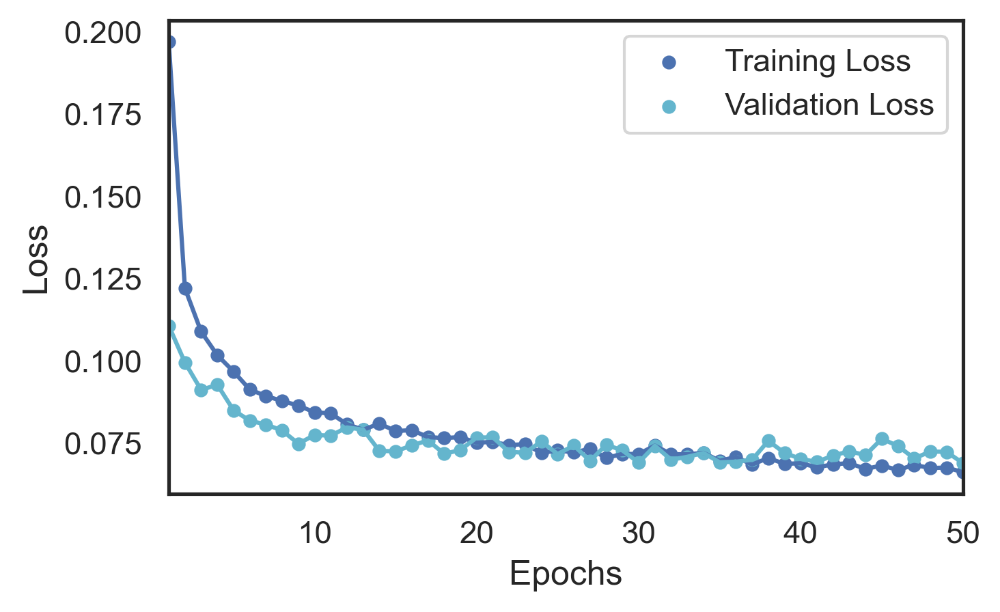

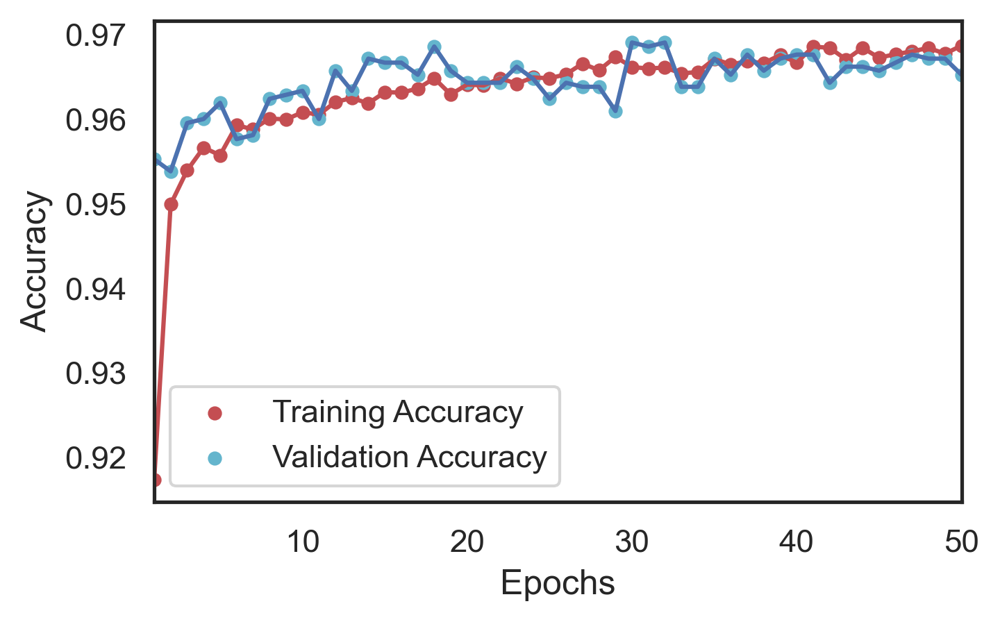

In [600]:

# Assuming you have the epochs results in 'loss_values' and 'accuracy_values' variables
plot_epochs_results(historyCNNO.history['loss'],
                    historyCNNO.history['val_loss'],
                    historyCNNO.history['accuracy'],
                    historyCNNO.history['val_accuracy'],'CNNOriginal')


In [538]:
from keras.models import Sequential
# from tensorflow.keras.utils import to_categorical
from keras.layers import Dense, LSTM,Embedding,Bidirectional,Dropout
model = Sequential()
# model.add(Embedding(voc_size, embed_size, weights=[embedding_matrix]))
model.add(Embedding(1000,100, input_length=X_train.shape[1]))
model.add(layers.GRU(128))
model.add(Activation('relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(32,activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(loss = 'binary_crossentropy',optimizer = 'adam' ,metrics=['accuracy'])
print(model.summary())

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_35 (Embedding)    (None, 20, 100)           100000    
                                                                 
 gru_2 (GRU)                 (None, 128)               88320     
                                                                 
 activation_13 (Activation)  (None, 128)               0         
                                                                 
 dropout_36 (Dropout)        (None, 128)               0         
                                                                 
 dense_140 (Dense)           (None, 32)                4128      
                                                                 
 dense_141 (Dense)           (None, 2)                 66        
                                                                 
Total params: 192,514
Trainable params: 192,514
Non-t

In [539]:
y_train1 = pd.get_dummies(y_train).values
y_test1= pd.get_dummies(y_test).values

historyGRUO=model.fit(X_train,y_train1, validation_split=0.1, epochs=50)
import numpy as np
# ----- Evaluate model -----
#probabilities = model.predict(x_test)
#pred = np.argmax(probabilities, axis=1)

print("Results")

#print(classification_report(y_test, probabilities.round()))
#cf_matrix=confusion_matrix(y_test, probabilities.round())
#cf_matrix

predict_x=model.predict(X_test) 
classes_x=np.argmax(predict_x,axis=1)
rounded_labels=np.argmax(y_test1, axis=1)
print(classification_report(rounded_labels,classes_x))
print(confusion_matrix(rounded_labels,classes_x))

Epoch 1/50
591/591 [==============================] - 37s 55ms/step - loss: 0.3249 - accuracy: 0.8740 - val_loss: 0.1888 - val_accuracy: 0.9195
Epoch 2/50
591/591 [==============================] - 33s 55ms/step - loss: 0.1697 - accuracy: 0.9295 - val_loss: 0.1335 - val_accuracy: 0.9433
Epoch 3/50
591/591 [==============================] - 34s 58ms/step - loss: 0.1323 - accuracy: 0.9447 - val_loss: 0.1160 - val_accuracy: 0.9481
Epoch 4/50
591/591 [==============================] - 34s 57ms/step - loss: 0.1171 - accuracy: 0.9506 - val_loss: 0.1133 - val_accuracy: 0.9448
Epoch 5/50
591/591 [==============================] - 35s 58ms/step - loss: 0.1064 - accuracy: 0.9527 - val_loss: 0.0951 - val_accuracy: 0.9552
Epoch 6/50
591/591 [==============================] - 34s 58ms/step - loss: 0.0981 - accuracy: 0.9574 - val_loss: 0.0956 - val_accuracy: 0.9505
Epoch 7/50
591/591 [==============================] - 34s 58ms/step - loss: 0.0918 - accuracy: 0.9584 - val_loss: 0.0943 - val_accuracy:

# Proposed

dataF.to_csv('ProposedUpsamplingData1.csv')

dataF1=pd.read_csv('SDNProposedUpsamplingData1.csv')

dataF=dataF.drop('Unnamed: 0',axis=1)

In [17]:
target1=dataF['target']
feature1=dataF.drop('target',axis=1)

In [18]:
Counter(target1)

Counter({'Normal': 133249, 'Anomaly': 133249})

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 44900 samples in 0.002s...
[t-SNE] Computed neighbors for 44900 samples in 30.688s...
[t-SNE] Computed conditional probabilities for sample 1000 / 44900
[t-SNE] Computed conditional probabilities for sample 2000 / 44900
[t-SNE] Computed conditional probabilities for sample 3000 / 44900
[t-SNE] Computed conditional probabilities for sample 4000 / 44900
[t-SNE] Computed conditional probabilities for sample 5000 / 44900
[t-SNE] Computed conditional probabilities for sample 6000 / 44900
[t-SNE] Computed conditional probabilities for sample 7000 / 44900
[t-SNE] Computed conditional probabilities for sample 8000 / 44900
[t-SNE] Computed conditional probabilities for sample 9000 / 44900
[t-SNE] Computed conditional probabilities for sample 10000 / 44900
[t-SNE] Computed conditional probabilities for sample 11000 / 44900
[t-SNE] Computed conditional probabilities for sample 12000 / 44900
[t-SNE] Computed conditional probabilities for s

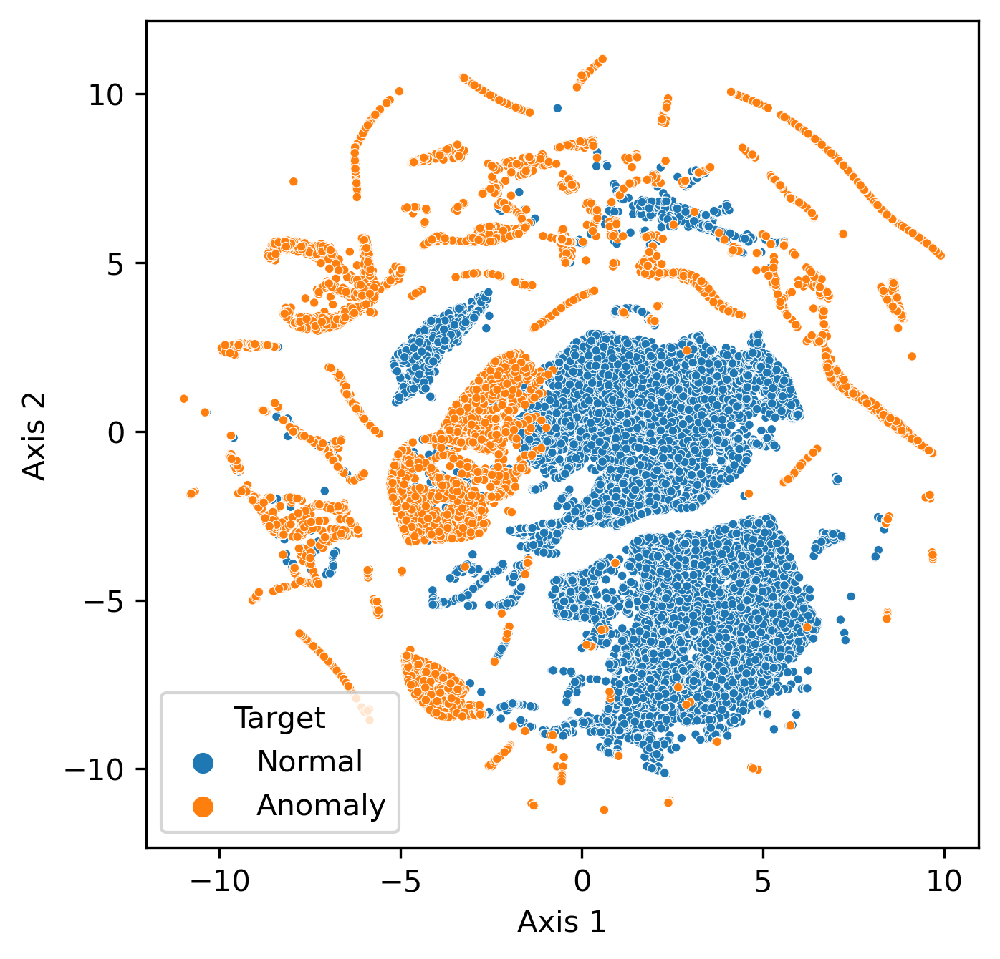

In [756]:
tar=dataF['target']
fe=dataF.drop('target',axis=1)

import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(fe)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))



fe['Axis 1'] = tsne_results[:,0]
fe['Axis 2'] = tsne_results[:,1]
tar.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
plt.rcParams.update(plt.rcParamsDefault)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=tar,
    data=fe,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=9
)
plt.savefig('MENbalanced.pdf')
plt.savefig('MENbalanced.png')

In [19]:
from collections import Counter
Counter(target1)

Counter({'Normal': 133249, 'Anomaly': 133249})

In [20]:
X_train, X_test, y_train, y_test = train_test_split(feature1, target1, test_size=0.30, random_state=1, stratify=target1, shuffle=True)
    

In [29]:
from mealpy.swarm_based.PSO import BasePSO
from mealpy.evolutionary_based.GA import BaseGA
from mealpy.evolutionary_based.DE import BaseDE
from mealpy.swarm_based.MFO import BaseMFO
import numpy as np

In [676]:

from keras.models import Sequential
# from tensorflow.keras.utils import to_categorical
from keras.layers import Dense, LSTM,Embedding,Bidirectional,Dropout
model = Sequential()
# model.add(Embedding(voc_size, embed_size, weights=[embedding_matrix]))
model.add(Embedding(1000,100, input_length=feature1.shape[1]))
model.add(LSTM(128))
model.add(Dropout(0.5))
model.add(Dense(64,activation='relu'))
model.add(Dense(32,activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(loss = 'binary_crossentropy',optimizer = 'adam' ,metrics=['accuracy'])
print(model.summary())

Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_42 (Embedding)    (None, 20, 100)           100000    
                                                                 
 lstm_85 (LSTM)              (None, 128)               117248    
                                                                 
 dropout_43 (Dropout)        (None, 128)               0         
                                                                 
 dense_157 (Dense)           (None, 64)                8256      
                                                                 
 dense_158 (Dense)           (None, 32)                2080      
                                                                 
 dense_159 (Dense)           (None, 2)                 66        
                                                                 
Total params: 227,650
Trainable params: 227,650
Non-t

In [677]:

y_train1 = pd.get_dummies(y_train).values
y_test1= pd.get_dummies(y_test).values

historyDATE=model.fit(X_train,y_train1, validation_split=0.1, epochs=50)
import numpy as np
# ----- Evaluate model -----
#probabilities = model.predict(x_test)
#pred = np.argmax(probabilities, axis=1)

print("Results")

#print(classification_report(y_test, probabilities.round()))
#cf_matrix=confusion_matrix(y_test, probabilities.round())
#cf_matrix

predict_x=model.predict(X_test) 
classes_x=np.argmax(predict_x,axis=1)
rounded_labels=np.argmax(y_test1, axis=1)
print(classification_report(rounded_labels,classes_x))
print(confusion_matrix(rounded_labels,classes_x))


Epoch 1/50
884/884 [==============================] - 49s 52ms/step - loss: 0.2628 - accuracy: 0.8858 - val_loss: 0.1571 - val_accuracy: 0.9383
Epoch 2/50
884/884 [==============================] - 36s 40ms/step - loss: 0.1347 - accuracy: 0.9447 - val_loss: 0.1148 - val_accuracy: 0.9596
Epoch 3/50
884/884 [==============================] - 36s 40ms/step - loss: 0.1008 - accuracy: 0.9579 - val_loss: 0.0929 - val_accuracy: 0.9602
Epoch 4/50
884/884 [==============================] - 36s 41ms/step - loss: 0.0876 - accuracy: 0.9617 - val_loss: 0.0853 - val_accuracy: 0.9605
Epoch 5/50
884/884 [==============================] - 36s 41ms/step - loss: 0.0822 - accuracy: 0.9642 - val_loss: 0.0784 - val_accuracy: 0.9644
Epoch 6/50
884/884 [==============================] - 35s 39ms/step - loss: 0.0773 - accuracy: 0.9651 - val_loss: 0.0777 - val_accuracy: 0.9666
Epoch 7/50
884/884 [==============================] - 34s 38ms/step - loss: 0.0711 - accuracy: 0.9666 - val_loss: 0.0803 - val_accuracy:

In [715]:
import matplotlib.pyplot as plt

def plot_epochs_results(loss_values,vlloss_values, accuracy_values, vlaccuracy_values,A):
    epochs = range(1, len(loss_values) + 1)
    
    # Plotting loss values as scatter plot
    plt.figure(figsize=(5, 3),dpi=300)
    plt.rcParams.update(plt.rcParamsDefault)
    plt.scatter(epochs, loss_values, c='b', label='Training Loss',s=15)
    plt.scatter(epochs, vlloss_values, c='c', label='Validation Loss',s=15)
    plt.plot(epochs, loss_values, 'b')
    plt.plot(epochs, vlloss_values, 'c')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt. margins(x=0)
    plt.savefig(A+'Loss.pdf',bbox_inches = 'tight', pad_inches = 0)



    # Plotting accuracy values as scatter plot
    plt.figure(figsize=(5, 3),dpi=300)
    plt.scatter(epochs, accuracy_values, c='r', label='Training Accuracy',s=15)
    plt.scatter(epochs, vlaccuracy_values, c='c', label='Validation Accuracy',s=15)
    plt.plot(epochs, accuracy_values, 'r')
    plt.plot(epochs, vlaccuracy_values, 'b')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt. margins(x=0)
    plt.savefig(A+'acc.pdf',bbox_inches = 'tight', pad_inches = 0)
    plt.show()

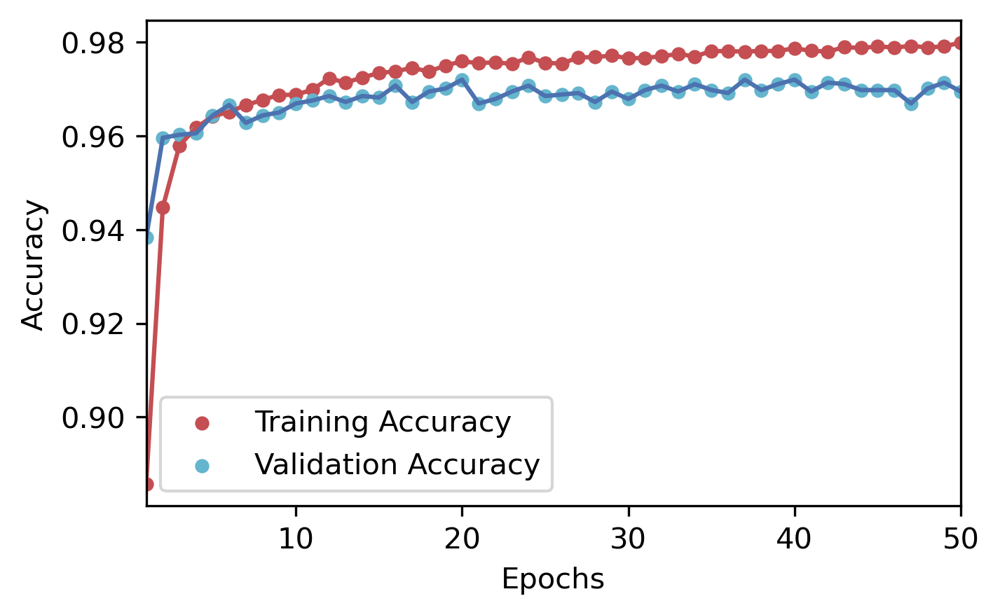

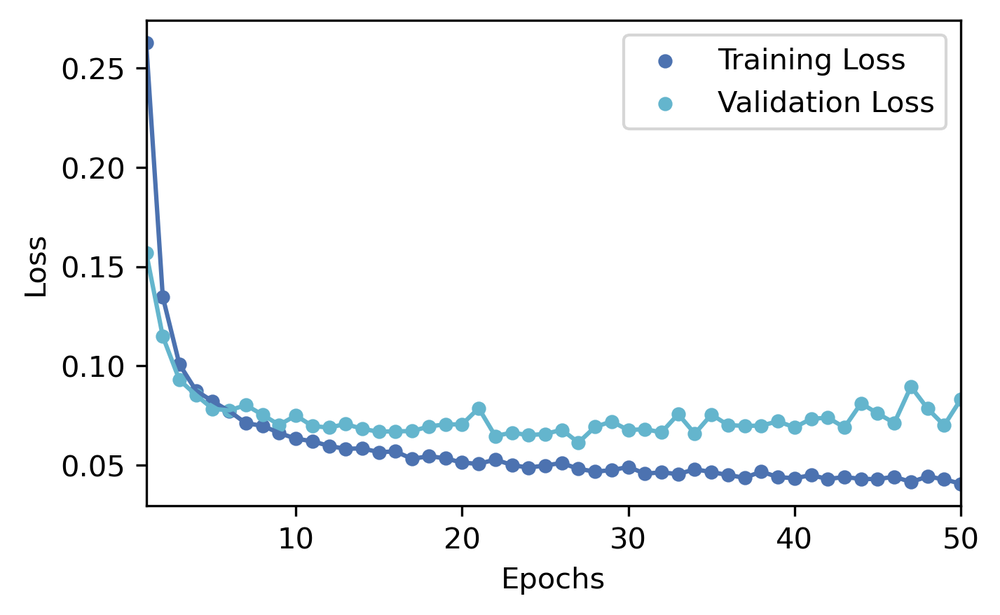

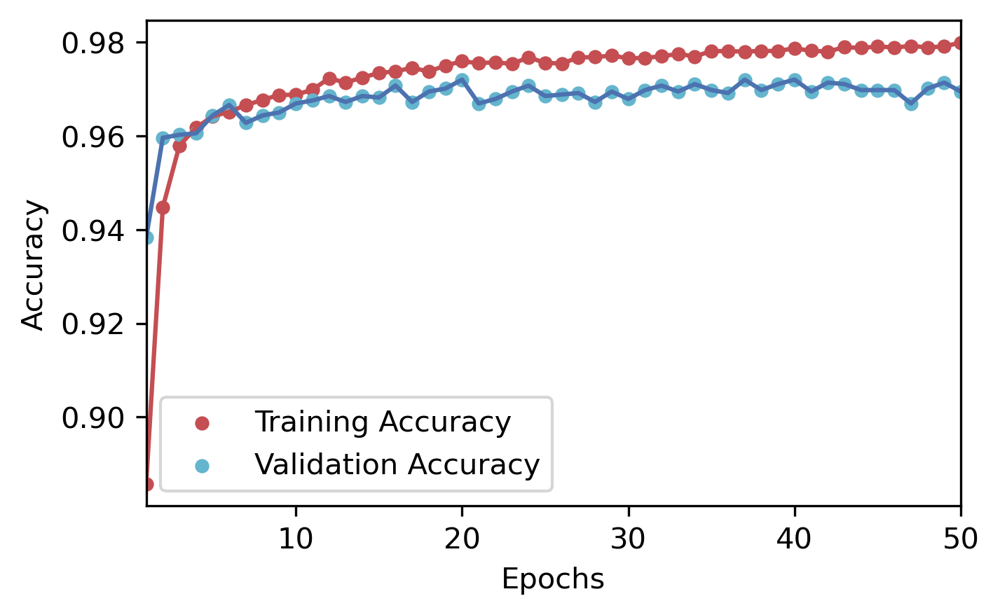

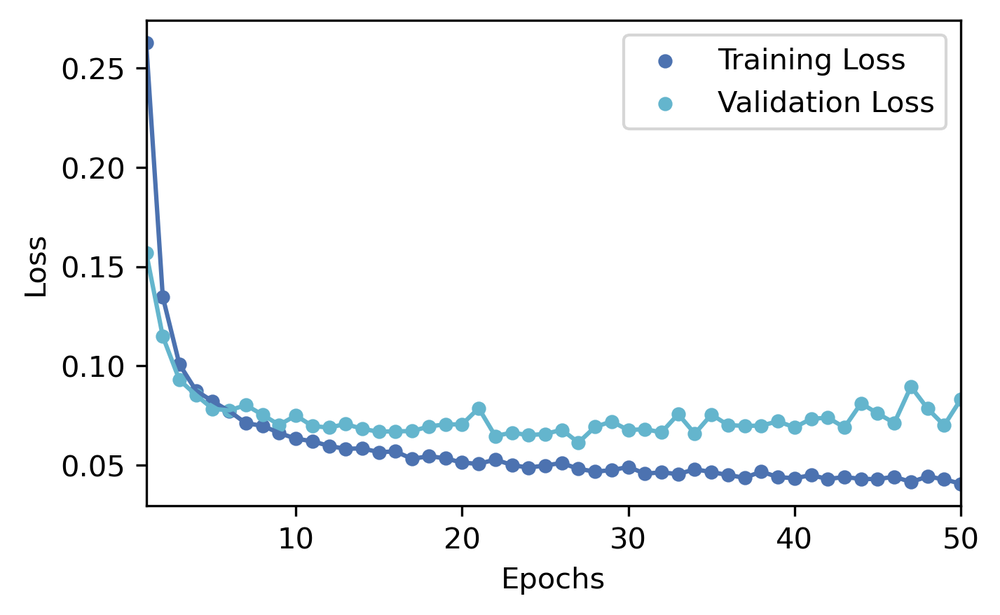

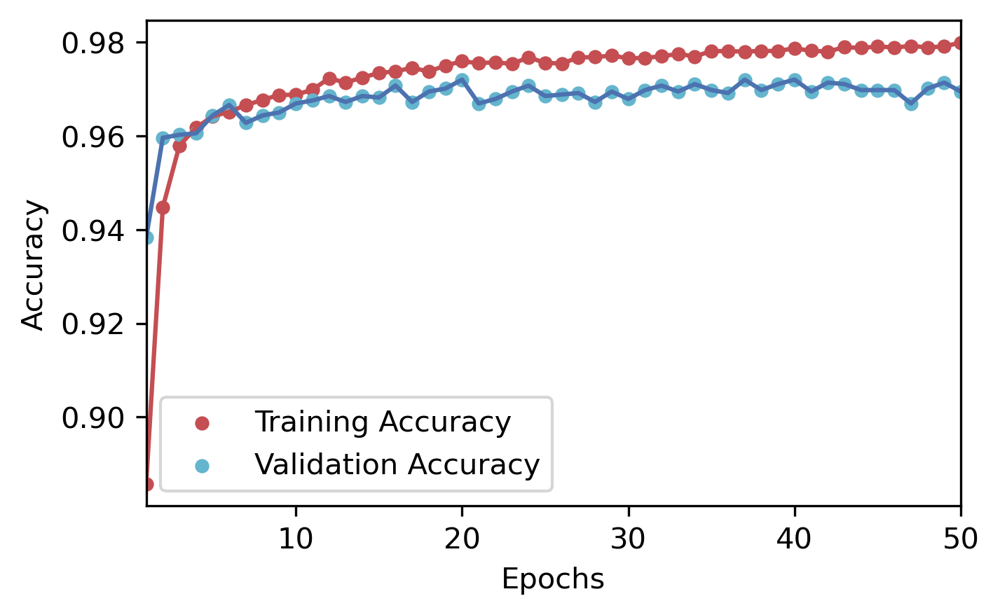

In [716]:

# Assuming you have the epochs results in 'loss_values' and 'accuracy_values' variables
plot_epochs_results(historyDATE.history['loss'],
                    historyDATE.history['val_loss'],
                    historyDATE.history['accuracy'],
                    historyDATE.history['val_accuracy'],'LSTMSDATE')

In [679]:
from keras.models import Sequential
# from tensorflow.keras.utils import to_categorical
from keras.layers import Dense, LSTM,Embedding,Bidirectional,Dropout
model = Sequential()
# model.add(Embedding(voc_size, embed_size, weights=[embedding_matrix]))
model.add(Embedding(1000,100, input_length=X_train.shape[1]))
model.add(Conv1D(128, 3, activation='relu'))
model.add(MaxPooling1D(pool_size=3))
model.add(Activation('relu'))
model.add(Dropout(rate=0.5))
model.add(Flatten())
model.add(Dense(32,activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(loss = 'binary_crossentropy',optimizer = 'adam' ,metrics=['accuracy'])
print(model.summary())

Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_43 (Embedding)    (None, 20, 100)           100000    
                                                                 
 conv1d_3 (Conv1D)           (None, 18, 128)           38528     
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 6, 128)           0         
 1D)                                                             
                                                                 
 activation_17 (Activation)  (None, 6, 128)            0         
                                                                 
 dropout_44 (Dropout)        (None, 6, 128)            0         
                                                                 
 flatten_13 (Flatten)        (None, 768)               0         
                                                     

In [680]:
y_train1 = pd.get_dummies(y_train).values
y_test1= pd.get_dummies(y_test).values

historyCNNDATE=model.fit(X_train,y_train1, validation_split=0.1, epochs=50)
import numpy as np
# ----- Evaluate model -----
#probabilities = model.predict(x_test)
#pred = np.argmax(probabilities, axis=1)

print("Results")

#print(classification_report(y_test, probabilities.round()))
#cf_matrix=confusion_matrix(y_test, probabilities.round())
#cf_matrix

predict_x=model.predict(X_test) 
classes_x=np.argmax(predict_x,axis=1)
rounded_labels=np.argmax(y_test1, axis=1)
print(classification_report(rounded_labels,classes_x))
print(confusion_matrix(rounded_labels,classes_x))

Epoch 1/50
884/884 [==============================] - 14s 15ms/step - loss: 0.1603 - accuracy: 0.9380 - val_loss: 0.0963 - val_accuracy: 0.9615
Epoch 2/50
884/884 [==============================] - 13s 14ms/step - loss: 0.1029 - accuracy: 0.9589 - val_loss: 0.0849 - val_accuracy: 0.9631
Epoch 3/50
884/884 [==============================] - 13s 15ms/step - loss: 0.0888 - accuracy: 0.9619 - val_loss: 0.0792 - val_accuracy: 0.9672
Epoch 4/50
884/884 [==============================] - 13s 15ms/step - loss: 0.0849 - accuracy: 0.9627 - val_loss: 0.0742 - val_accuracy: 0.9631
Epoch 5/50
884/884 [==============================] - 12s 13ms/step - loss: 0.0794 - accuracy: 0.9636 - val_loss: 0.0761 - val_accuracy: 0.9647
Epoch 6/50
884/884 [==============================] - 12s 14ms/step - loss: 0.0763 - accuracy: 0.9667 - val_loss: 0.0722 - val_accuracy: 0.9647
Epoch 7/50
884/884 [==============================] - 13s 14ms/step - loss: 0.0730 - accuracy: 0.9660 - val_loss: 0.0704 - val_accuracy:

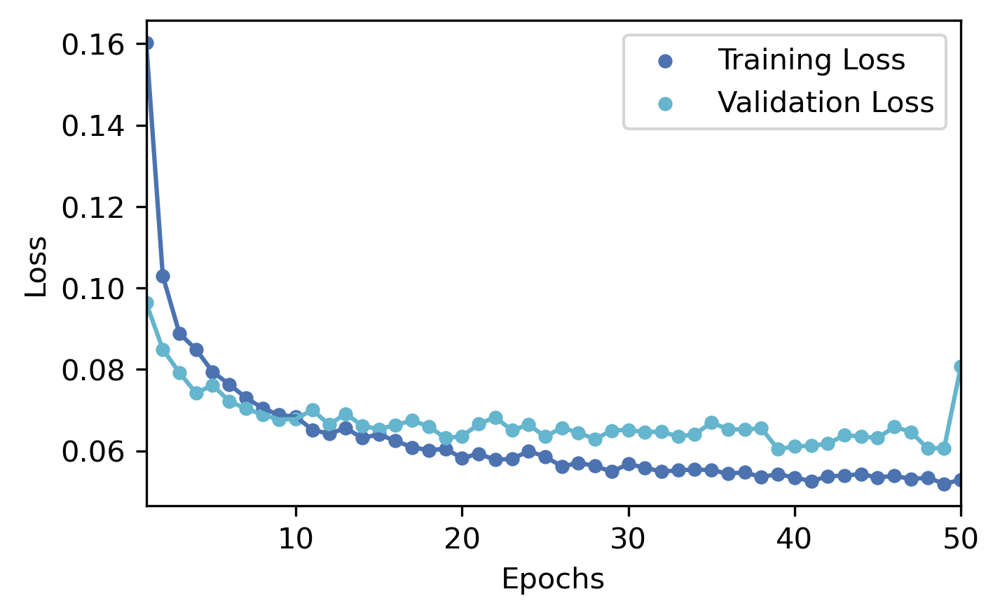

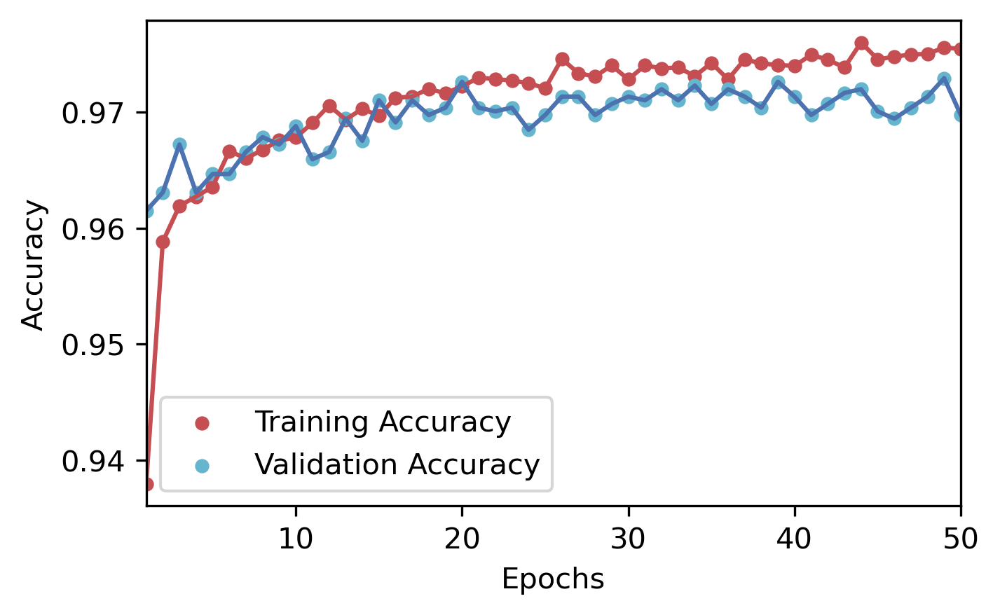

In [717]:
# Assuming you have the epochs results in 'loss_values' and 'accuracy_values' variables
plot_epochs_results(historyCNNDATE.history['loss'],
                    historyCNNDATE.history['val_loss'],
                    historyCNNDATE.history['accuracy'],
                    historyCNNDATE.history['val_accuracy'],'CNNSDATE')

In [682]:
from keras.models import Sequential
# from tensorflow.keras.utils import to_categorical
from keras.layers import Dense, LSTM,Embedding,Bidirectional,Dropout
model = Sequential()
# model.add(Embedding(voc_size, embed_size, weights=[embedding_matrix]))
model.add(Embedding(1000,100, input_length=X_train.shape[1]))
model.add(layers.GRU(128))
model.add(Activation('relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(32,activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(loss = 'binary_crossentropy',optimizer = 'adam' ,metrics=['accuracy'])
print(model.summary())

Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_44 (Embedding)    (None, 20, 100)           100000    
                                                                 
 gru_4 (GRU)                 (None, 128)               88320     
                                                                 
 activation_18 (Activation)  (None, 128)               0         
                                                                 
 dropout_45 (Dropout)        (None, 128)               0         
                                                                 
 dense_162 (Dense)           (None, 32)                4128      
                                                                 
 dense_163 (Dense)           (None, 2)                 66        
                                                                 
Total params: 192,514
Trainable params: 192,514
Non-t

In [683]:
y_train1 = pd.get_dummies(y_train).values
y_test1= pd.get_dummies(y_test).values

historyGRUDATE=model.fit(X_train,y_train1, validation_split=0.1, epochs=50)
import numpy as np
# ----- Evaluate model -----
#probabilities = model.predict(x_test)
#pred = np.argmax(probabilities, axis=1)

print("Results")

#print(classification_report(y_test, probabilities.round()))
#cf_matrix=confusion_matrix(y_test, probabilities.round())
#cf_matrix

predict_x=model.predict(X_test) 
classes_x=np.argmax(predict_x,axis=1)
rounded_labels=np.argmax(y_test1, axis=1)
print(classification_report(rounded_labels,classes_x))
print(confusion_matrix(rounded_labels,classes_x))

Epoch 1/50
884/884 [==============================] - 49s 52ms/step - loss: 0.2773 - accuracy: 0.8875 - val_loss: 0.1866 - val_accuracy: 0.9271
Epoch 2/50
884/884 [==============================] - 44s 50ms/step - loss: 0.1418 - accuracy: 0.9426 - val_loss: 0.1076 - val_accuracy: 0.9539
Epoch 3/50
884/884 [==============================] - 44s 50ms/step - loss: 0.1021 - accuracy: 0.9574 - val_loss: 0.0930 - val_accuracy: 0.9618
Epoch 4/50
884/884 [==============================] - 44s 50ms/step - loss: 0.0898 - accuracy: 0.9625 - val_loss: 0.1000 - val_accuracy: 0.9625
Epoch 5/50
884/884 [==============================] - 45s 51ms/step - loss: 0.0821 - accuracy: 0.9649 - val_loss: 0.0790 - val_accuracy: 0.9647
Epoch 6/50
884/884 [==============================] - 45s 51ms/step - loss: 0.0758 - accuracy: 0.9672 - val_loss: 0.0799 - val_accuracy: 0.9634
Epoch 7/50
884/884 [==============================] - 44s 50ms/step - loss: 0.0741 - accuracy: 0.9676 - val_loss: 0.0748 - val_accuracy:

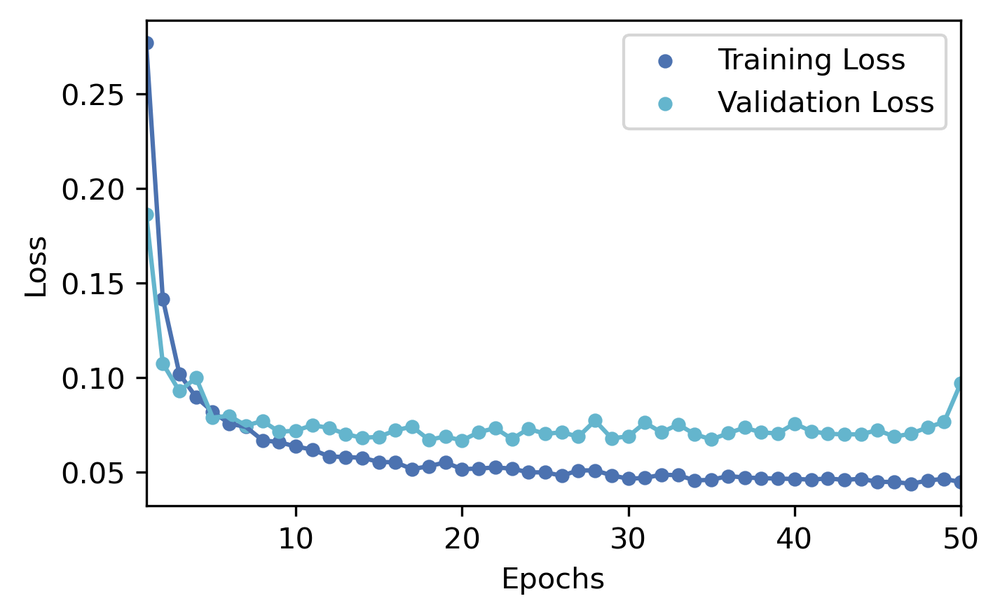

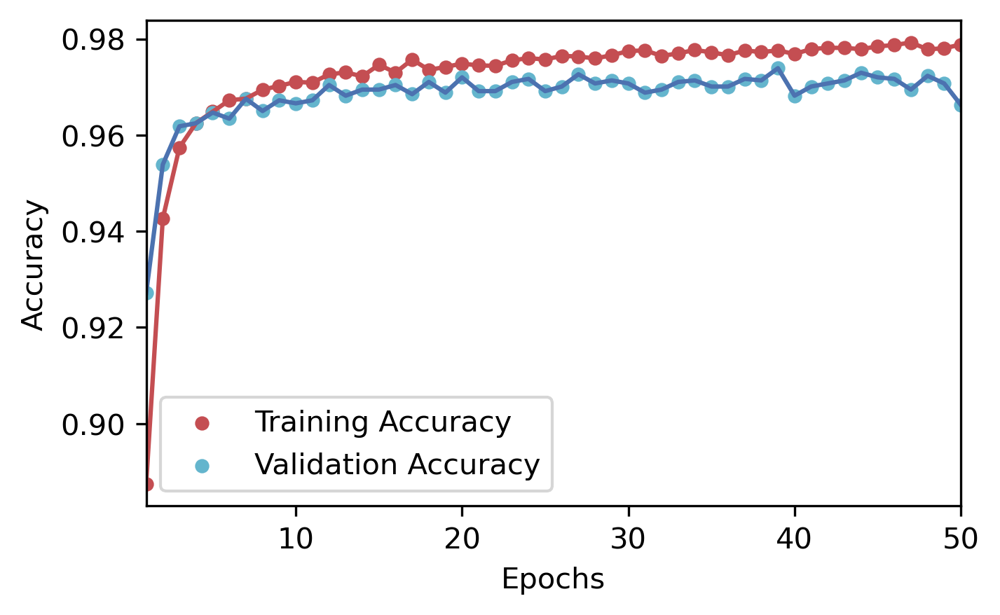

In [718]:
# Assuming you have the epochs results in 'loss_values' and 'accuracy_values' variables
plot_epochs_results(historyGRUDATE.history['loss'],
                    historyGRUDATE.history['val_loss'],
                    historyGRUDATE.history['accuracy'],
                    historyGRUDATE.history['val_accuracy'],'GRUSDATE')

In [455]:
import lightgbm as lgb
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


sol0E=[]
sol1E=[]
accE=[]
from sklearn.ensemble import ExtraTreesClassifier
def fitness_function(solution):
    print(solution)
    rf_model1 = RandomForestClassifier(n_estimators=int(solution[0]),max_depth=int(solution[1]))
    rf_model2=  AdaBoostClassifier(n_estimators=int(solution[2]), random_state=5,learning_rate=solution[3])
    rf_model3 = ExtraTreesClassifier(n_estimators=int(solution[4]),max_depth=int(solution[5]))

    # Create the stack ensemble classifier
    ensemble_model = VotingClassifier(estimators=[('rf', rf_model1), ('rf1', rf_model2), ('rf2', rf_model3)], voting='soft')
    #stack_ensemble = StackingClassifier(estimators=[('rf1', rf_model1), ('rf2', rf_model1), ('rf3', rf_model3)], final_estimator=meta_model)
    # Fit the stack ensemble classifier on the training data
    ensemble_model.fit(X_train, y_train)
    pred=ensemble_model.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accE.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [2, 2,2, 0.01,2, 2],
    "ub": [300, 200,300,1,300,200],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
     


model = BasePSO(problem,epoch=10, pop_size=5, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=5, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")






[ 14.52719623   7.55563604 254.18647762   0.47119864 257.32791973
  63.11185323]
0.9839643652561247
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.98      6735
      Normal       0.99      0.98      0.98      6735

    accuracy                           0.98     13470
   macro avg       0.98      0.98      0.98     13470
weighted avg       0.98      0.98      0.98     13470

[[6681   54]
 [ 162 6573]]
0.9839643652561247
[296.70515424 163.71136014 195.48648651   0.46099697 277.01611471
 126.44692131]
0.9872308834446919
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.99      6735
      Normal       0.99      0.98      0.99      6735

    accuracy                           0.99     13470
   macro avg       0.99      0.99      0.99     13470
weighted avg       0.99      0.99      0.99     13470

[[6669   66]
 [ 106 6629]]
0.9872308834446919
[ 74.14909758  36.08016075 276.66745652   0.82095183 2

0.9873793615441723
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99      6735
      Normal       0.99      0.99      0.99      6735

    accuracy                           0.99     13470
   macro avg       0.99      0.99      0.99     13470
weighted avg       0.99      0.99      0.99     13470

[[6665   70]
 [ 100 6635]]
0.9873793615441723
[164.17764459 149.90137606  57.27354412   0.36465696 160.73931571
  20.35197428]
0.9871566443949518
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.99      6735
      Normal       0.99      0.98      0.99      6735

    accuracy                           0.99     13470
   macro avg       0.99      0.99      0.99     13470
weighted avg       0.99      0.99      0.99     13470

[[6677   58]
 [ 115 6620]]
0.9871566443949518
[2.31918969e+02 1.49361037e+02 7.11953753e+01 2.40432402e-01
 2.50965243e+02 1.57896985e+02]
0.9875278396436525
              precision

0.9873793615441723
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99      6735
      Normal       0.99      0.99      0.99      6735

    accuracy                           0.99     13470
   macro avg       0.99      0.99      0.99     13470
weighted avg       0.99      0.99      0.99     13470

[[6659   76]
 [  94 6641]]
0.9873793615441723
[119.39918274  76.18612737  60.38311393   0.33396681 106.39144191
  13.96339245]
0.9868596881959911
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.99      6735
      Normal       0.99      0.98      0.99      6735

    accuracy                           0.99     13470
   macro avg       0.99      0.99      0.99     13470
weighted avg       0.99      0.99      0.99     13470

[[6694   41]
 [ 136 6599]]
0.9868596881959911
> Epoch: 6, Current best: 0.9878990348923534, Global best: 0.9878990348923534, Runtime: 124.89882 seconds
[ 83.5938959   37.2847599   2

0.9868596881959911
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.99      6735
      Normal       0.99      0.98      0.99      6735

    accuracy                           0.99     13470
   macro avg       0.99      0.99      0.99     13470
weighted avg       0.99      0.99      0.99     13470

[[6662   73]
 [ 104 6631]]
0.9868596881959911
[ 96.20618446  66.02576446 224.27355787   0.49438636 243.87348533
 189.88331948]
0.987305122494432
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.99      6735
      Normal       0.99      0.98      0.99      6735

    accuracy                           0.99     13470
   macro avg       0.99      0.99      0.99     13470
weighted avg       0.99      0.99      0.99     13470

[[6669   66]
 [ 105 6630]]
0.987305122494432
[153.35120127 121.81179784   8.63990624   0.38051641 190.39601718
  21.55566458]
0.9870824053452116
              precision    recall  f1

In [31]:
%%time

import lightgbm as lgb
from sklearn.ensemble import StackingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


sol0E=[]
sol1E=[]
accE=[]
from sklearn.ensemble import ExtraTreesClassifier
def fitness_function(solution):
    print(solution)
    rf_model1 = RandomForestClassifier(n_estimators=int(solution[0]),max_depth=int(solution[1]))
    rf_model2= RandomForestClassifier(n_estimators=int(solution[2]),max_depth=int(solution[3]))
    rf_model3 = RandomForestClassifier(n_estimators=int(solution[4]),max_depth=int(solution[5]))

    # Create the stack ensemble classifier
    ensemble_model = VotingClassifier(estimators=[('rf', rf_model1), ('rf1', rf_model2), ('rf2', rf_model3)], voting='soft')
    #stack_ensemble = StackingClassifier(estimators=[('rf1', rf_model1), ('rf2', rf_model1), ('rf3', rf_model3)], final_estimator=meta_model)
    # Fit the stack ensemble classifier on the training data
    ensemble_model.fit(X_train, y_train)
    pred=ensemble_model.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accE.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [2, 2,2, 2,2, 2],
    "ub": [300, 200,300,200,300,200],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


model = BasePSO(problem,epoch=10, pop_size=5, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")






[ 45.68489669 114.99971943 198.02982646 156.40151738  71.62864492
  61.91329309]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[291.03805291  38.98805815 186.1409954    2.70280965  55.66125946
 158.42406888]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[295.93773551 176.70261552 252.11149368  93.75706021 210.24391865
 139.39383324]
1.0
              precisi

1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[ 90.63168008  68.43216969  99.86605164 130.46180617 157.88736478
  89.46667795]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[105.98710422  58.86759051 123.33586364 140.5689119  181.54133409
   5.00875833]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00    

1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[ 41.77120219 175.39110814 122.01614358  51.70719963 232.2626565
 153.14770571]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[ 32.66826309 162.14636977 173.63350011  82.8598137  184.661297
 126.28193716]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39

1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[ 21.75533655 103.59388827 216.2935085  191.19511913 211.6469386
 131.5916768 ]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
> Epoch: 10, Current best: 1.0, Global best: 1.0, Runtime: 487.48163 seconds
Best solution: [ 37.85351334 119.66483854 218.46951208 170.74606108 224.59684339
 129.2139275 ], Best fitness: 

In [30]:
%%time
from sklearn.ensemble import VotingClassifier
import lightgbm as lgb
from sklearn.ensemble import StackingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


sol0E=[]
sol1E=[]
accE=[]
from sklearn.ensemble import ExtraTreesClassifier
def fitness_function(solution):
    print(solution)
    rf_model1 = RandomForestClassifier(n_estimators=int(solution[0]),max_depth=int(solution[1]))
    rf_model2=  AdaBoostClassifier(n_estimators=int(solution[2]), random_state=5,learning_rate=solution[3])
    rf_model3 = ExtraTreesClassifier(n_estimators=int(solution[4]),max_depth=int(solution[5]))

    # Create the stack ensemble classifier
    ensemble_model = VotingClassifier(estimators=[('rf', rf_model1), ('rf1', rf_model2), ('rf2', rf_model3)], voting='soft')
    #stack_ensemble = StackingClassifier(estimators=[('rf1', rf_model1), ('rf2', rf_model1), ('rf3', rf_model3)], final_estimator=meta_model)
    # Fit the stack ensemble classifier on the training data
    ensemble_model.fit(X_train, y_train)
    pred=ensemble_model.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accE.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [2, 2,2, 0.01,2, 2],
    "ub": [300, 200,300,1,300,200],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseGA(problem,epoch=10, pop_size=5, pr=0.03)
#model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")






[145.92374488  98.9844985  294.70164227   0.65009148 246.75429275
  92.35446113]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[1.60561528e+02 1.15479625e+02 2.61775421e+02 1.32386672e-01
 1.87441512e+02 1.26774964e+02]
1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
[198.59111211 137.94407275  98.39227904   0.56426383  24.88721454
   2.21109273]
1.0
         

TypeError: list indices must be integers or slices, not NoneType

In [32]:
    %%time
    rf_model1 = RandomForestClassifier(n_estimators=100,max_depth=10)
    rf_model2=  AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.5)
    rf_model3 = ExtraTreesClassifier(n_estimators=100,max_depth=10)

    # Create the stack ensemble classifier
    ensemble_model = VotingClassifier(estimators=[('rf', rf_model1), ('rf1', rf_model2), ('rf2', rf_model3)], voting='soft')
    #stack_ensemble = StackingClassifier(estimators=[('rf1', rf_model1), ('rf2', rf_model1), ('rf3', rf_model3)], final_estimator=meta_model)
    # Fit the stack ensemble classifier on the training data
    ensemble_model.fit(X_train, y_train)
    pred=ensemble_model.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))

1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
Wall time: 31.1 s


In [48]:
    %%time
    pred=ensemble_model.predict(X_test[:1])

Wall time: 39.3 ms


In [719]:
array5=[[6668,   67],
 [  98, 6637]]
DEM = pd.DataFrame(array5, index = [i for i in "10"],
                  columns = [i for i in "10"])

array3=[[6705 ,  30],
 [ 198 ,6537]]
EM = pd.DataFrame(array3, index = [i for i in "10"],
                  columns = [i for i in "10"])



array4=[[6674 ,  61],
 [  82, 6653]]
DSEM = pd.DataFrame(array4, index = [i for i in "10"],
                  columns = [i for i in "10"])

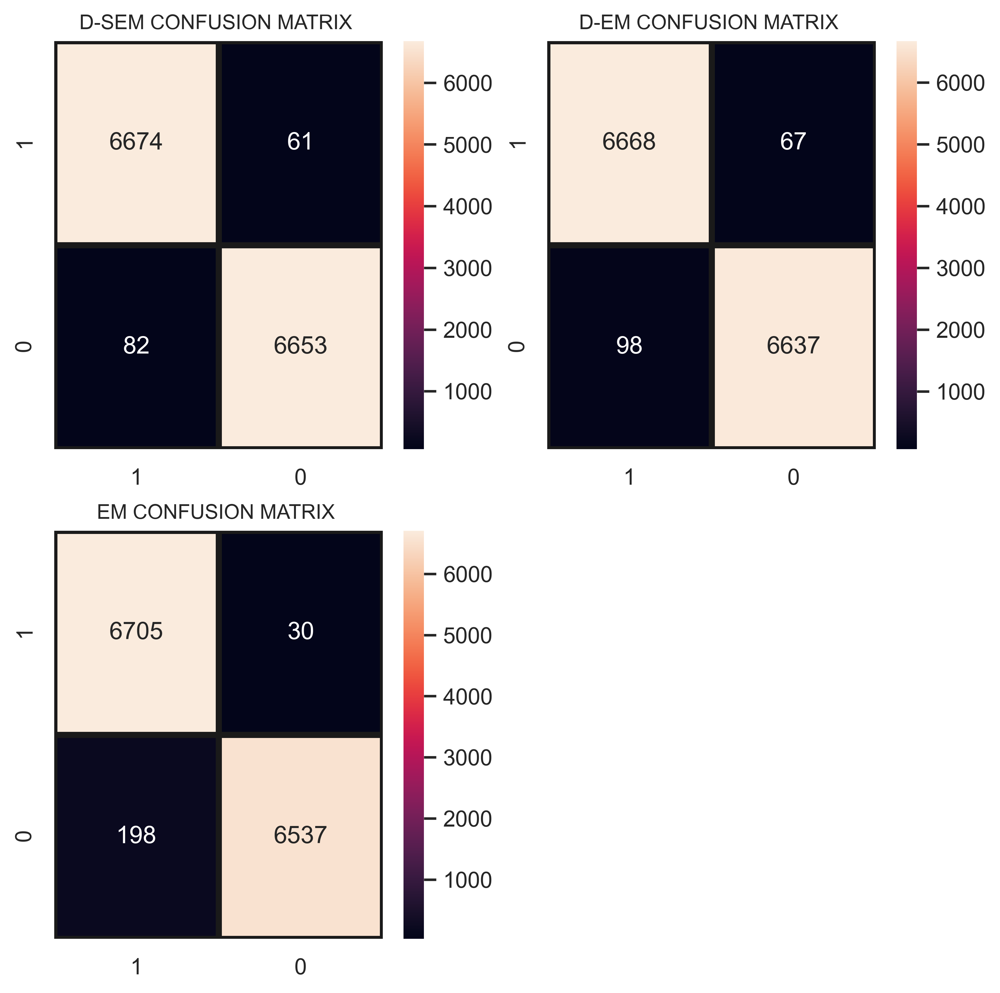

In [746]:
i=1
def plot_sub_sentiment(Airline,A):
    sns.set()
    #tmp = rfc.fit(X_train, y_train.ravel())
    sns.heatmap(Airline,annot=True,fmt = "d",linecolor="k",linewidths=3)
    plt.title(A+" CONFUSION MATRIX ",fontsize=10)

plt.figure(1,figsize=(8, 8),dpi=500)
plt.subplot(221) 
plot_sub_sentiment(DSEM,'D-SEM')
plt.subplot(222)
plot_sub_sentiment(DEM,'D-EM')
plt.subplot(223)
plot_sub_sentiment(EM,'EM')


plt.savefig('confdSEN.pdf')
plt.show()


In [40]:
%%time
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
arf =  RandomForestClassifier(n_estimators=100, random_state=2,max_depth=10) 
a_pred = arf.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

1.0
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
Wall time: 23.2 s


In [41]:
    %%time
    pred=arf.predict(X_test[:1])

Wall time: 20.1 ms


In [670]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
a =  RandomForestClassifier(n_estimators=100, random_state=2,max_depth=16) 
# Perform cross-validation
results = cross_val_score(a, feature1, target1, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())


Cross-validation Results:  [0.99365256 0.99265033 0.99153675 0.9785078  0.96135857]
Mean Accuracy:  0.9835412026726058
Standard Deviation:  0.012381831666113017


In [38]:
%%time
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.2)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))
a=accuracy_score(y_test,xgb_pred)
print(a)

ADA
              precision    recall  f1-score   support

     Anomaly       1.00      1.00      1.00     39975
      Normal       1.00      1.00      1.00     39975

    accuracy                           1.00     79950
   macro avg       1.00      1.00      1.00     79950
weighted avg       1.00      1.00      1.00     79950

[[39975     0]
 [    0 39975]]
1.0
Wall time: 3.91 s


In [39]:
    %%time
    pred=xgb.predict(X_test[:1])

Wall time: 2.85 ms


In [673]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
xgb = AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.2)
# Perform cross-validation
results = cross_val_score(xgb, feature1, target1, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())


Cross-validation Results:  [0.99142539 0.98741648 0.98886414 0.95946548 0.94142539]
Mean Accuracy:  0.9737193763919821
Standard Deviation:  0.01988241783924256


In [42]:
%%time
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=100, random_state=5, max_depth=10)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))
a=accuracy_score(y_test,b_pred)
print(a)

ETC
              precision    recall  f1-score   support

     Anomaly       0.98      1.00      0.99     39975
      Normal       1.00      0.98      0.99     39975

    accuracy                           0.99     79950
   macro avg       0.99      0.99      0.99     79950
weighted avg       0.99      0.99      0.99     79950

[[39830   145]
 [  638 39337]]
0.9902063789868668
Wall time: 10.8 s


In [43]:
    %%time
    pred=b.predict(X_test[:1])

Wall time: 12 ms


In [675]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
b = ExtraTreesClassifier(n_estimators=100, random_state=5, max_depth=20)
# Perform cross-validation
results = cross_val_score(b, feature1, target1, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())


Cross-validation Results:  [0.99342984 0.9935412  0.99097996 0.96035635 0.94109131]
Mean Accuracy:  0.9758797327394209
Standard Deviation:  0.02144369474889778


In [44]:
%%time
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))
a=accuracy_score(y_test,y_pred_class)
print(a)

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

     Anomaly       0.50      1.00      0.67     39975
      Normal       0.00      0.00      0.00     39975

    accuracy                           0.50     79950
   macro avg       0.25      0.50      0.33     79950
weighted avg       0.25      0.50      0.33     79950

[[39975     0]
 [39975     0]]
0.5
Wall time: 3.89 s


In [45]:
    %%time
    pred=logreg.predict(X_test[:1])

Wall time: 2.03 ms


In [658]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0) 
# Perform cross-validation
results = cross_val_score(logreg, feature1, target1, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())


Cross-validation Results:  [0.93563474 0.91614699 0.89320713 0.86336303 0.84699332]
Mean Accuracy:  0.8910690423162583
Standard Deviation:  0.03264925541414111


# SMOTE

In [176]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(feature, target)

In [177]:
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size=0.30, random_state=1, stratify=y_res, shuffle=True)


In [467]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=100, random_state=2,max_depth=10) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9835189309576837
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.98      6735
      Normal       0.99      0.98      0.98      6735

    accuracy                           0.98     13470
   macro avg       0.98      0.98      0.98     13470
weighted avg       0.98      0.98      0.98     13470

[[6680   55]
 [ 167 6568]]
0.9835189309576837


In [468]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
a =  RandomForestClassifier(n_estimators=100, random_state=2,max_depth=10) 
# Perform cross-validation
results = cross_val_score(a, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())


Cross-validation Results:  [0.9775     0.974      0.97716667 0.97916667 0.974     ]
Mean Accuracy:  0.9763666666666666
Standard Deviation:  0.002047763007121024


In [469]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.2)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))
a=accuracy_score(y_test,xgb_pred)
print(a)

ADA
              precision    recall  f1-score   support

     Anomaly       0.95      0.96      0.96      6735
      Normal       0.96      0.95      0.96      6735

    accuracy                           0.96     13470
   macro avg       0.96      0.96      0.96     13470
weighted avg       0.96      0.96      0.96     13470

[[6476  259]
 [ 334 6401]]
0.9559762435040832


In [470]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
xgb = AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.2)
# Perform cross-validation
results = cross_val_score(xgb, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())

Cross-validation Results:  [0.95066667 0.95116667 0.9525     0.94983333 0.948     ]
Mean Accuracy:  0.9504333333333334
Standard Deviation:  0.0014929463784372717


In [471]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=100, random_state=5, max_depth=10)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))
a=accuracy_score(y_test,b_pred)
print(a)

ETC
              precision    recall  f1-score   support

     Anomaly       0.94      1.00      0.97      6735
      Normal       1.00      0.94      0.97      6735

    accuracy                           0.97     13470
   macro avg       0.97      0.97      0.97     13470
weighted avg       0.97      0.97      0.97     13470

[[6725   10]
 [ 423 6312]]
0.9678544914625092


In [472]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
b = ExtraTreesClassifier(n_estimators=100, random_state=5, max_depth=10)
# Perform cross-validation
results = cross_val_score(b, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())

Cross-validation Results:  [0.95733333 0.9595     0.959      0.9555     0.95683333]
Mean Accuracy:  0.9576333333333332
Standard Deviation:  0.0014583095236151513


In [473]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))
a=accuracy_score(y_test,y_pred_class)
print(a)

              precision    recall  f1-score   support

     Anomaly       0.88      0.91      0.89      6735
      Normal       0.90      0.88      0.89      6735

    accuracy                           0.89     13470
   macro avg       0.89      0.89      0.89     13470
weighted avg       0.89      0.89      0.89     13470

[[6107  628]
 [ 838 5897]]
0.8911655530809206


In [474]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# Perform cross-validation
results = cross_val_score(logreg, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())

Cross-validation Results:  [0.89716667 0.89533333 0.89683333 0.89433333 0.88916667]
Mean Accuracy:  0.8945666666666667
Standard Deviation:  0.002887905815638738


# Adasyn

In [475]:
from imblearn.over_sampling import ADASYN
ada = ADASYN()
X_resA, y_resY = ada.fit_resample(feature, target)

In [476]:
X_train, X_test, y_train, y_test = train_test_split(X_resA, y_resY, test_size=0.30, random_state=1, stratify=y_resY, shuffle=True)


In [477]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=100, random_state=2,max_depth=10) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.975780089153046
              precision    recall  f1-score   support

     Anomaly       1.00      0.95      0.98      6735
      Normal       0.95      1.00      0.98      6725

    accuracy                           0.98     13460
   macro avg       0.98      0.98      0.98     13460
weighted avg       0.98      0.98      0.98     13460

[[6411  324]
 [   2 6723]]
0.975780089153046


In [478]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
a =  RandomForestClassifier(n_estimators=100, random_state=2,max_depth=10) 
# Perform cross-validation
results = cross_val_score(a, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())

Cross-validation Results:  [0.9775     0.974      0.97716667 0.97916667 0.974     ]
Mean Accuracy:  0.9763666666666666
Standard Deviation:  0.002047763007121024


In [479]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.2)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))
a=accuracy_score(y_test,xgb_pred)
print(a)

ADA
              precision    recall  f1-score   support

     Anomaly       0.98      0.91      0.94      6735
      Normal       0.91      0.98      0.94      6725

    accuracy                           0.94     13460
   macro avg       0.94      0.94      0.94     13460
weighted avg       0.94      0.94      0.94     13460

[[6111  624]
 [ 148 6577]]
0.9426448736998514


In [480]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
xgb = AdaBoostClassifier(n_estimators=100, random_state=5,learning_rate=0.2)
# Perform cross-validation
results = cross_val_score(xgb, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())

Cross-validation Results:  [0.95066667 0.95116667 0.9525     0.94983333 0.948     ]
Mean Accuracy:  0.9504333333333334
Standard Deviation:  0.0014929463784372717


In [481]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=100, random_state=5, max_depth=10)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))
a=accuracy_score(y_test,b_pred)
print(a)

ETC
              precision    recall  f1-score   support

     Anomaly       0.92      0.93      0.92      6735
      Normal       0.93      0.92      0.92      6725

    accuracy                           0.92     13460
   macro avg       0.92      0.92      0.92     13460
weighted avg       0.92      0.92      0.92     13460

[[6258  477]
 [ 567 6158]]
0.9224368499257058


In [482]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
b = ExtraTreesClassifier(n_estimators=100, random_state=5, max_depth=10)
# Perform cross-validation
results = cross_val_score(b, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())

Cross-validation Results:  [0.95733333 0.9595     0.959      0.9555     0.95683333]
Mean Accuracy:  0.9576333333333332
Standard Deviation:  0.0014583095236151513


In [483]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))
a=accuracy_score(y_test,y_pred_class)
print(a)

              precision    recall  f1-score   support

     Anomaly       0.80      0.85      0.83      6735
      Normal       0.84      0.79      0.82      6725

    accuracy                           0.82     13460
   macro avg       0.82      0.82      0.82     13460
weighted avg       0.82      0.82      0.82     13460

[[5746  989]
 [1413 5312]]
0.8215453194650817


In [484]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# Perform cross-validation
results = cross_val_score(logreg, feature, target, cv=5)

# Print the results
print("Cross-validation Results: ", results)
print("Mean Accuracy: ", results.mean())
print("Standard Deviation: ", results.std())

Cross-validation Results:  [0.89716667 0.89533333 0.89683333 0.89433333 0.88916667]
Mean Accuracy:  0.8945666666666667
Standard Deviation:  0.002887905815638738


In [300]:
Data25=newfeatures[:163590]
dataNCTGAN=Data25.loc[Data25['target'] == "Normal"]
print(len(dataNCTGAN))
dataACTGAN=Data25.loc[Data25['target'] == "Anomaly"]
print(len(dataACTGAN))

30195
133395


In [301]:
dataNCTGAN.columns = dataNCTGAN.columns.astype(str)
dataACTGAN.columns = dataACTGAN.columns.astype(str)

In [305]:
dat=dataNCTGAN[:3000]
from sdv.tabular import CTGAN
model = CTGAN(epochs=100,verbose=True,batch_size=32)
model.fit(dataNCTGAN)

C:\Users\knowl\anaconda3\lib\site-packages\rdt\transformers\numerical.py:100: UserWarning: No rounding scheme detected for column '0'. Data will not be rounded.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\rdt\transformers\numerical.py:100: UserWarning: No rounding scheme detected for column '1'. Data will not be rounded.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\rdt\transformers\numerical.py:100: UserWarning: No rounding scheme detected for column '2'. Data will not be rounded.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\rdt\transformers\numerical.py:100: UserWarning: No rounding scheme detected for column '3'. Data will not be rounded.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\rdt\transformers\numerical.py:100: UserWarning: No rounding scheme detected for column '4'. Data will not be rounded.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\rdt\transformers\numerical.py:100: UserWarning: No rounding scheme 

AssertionError: 

In [ ]:
new_data_pii = model.sample(67824)

In [220]:
new_data_pii

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67819,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
67820,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
67821,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal
67822,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal


In [179]:
NewCTGANDATA=new_data_pii.append(dataNCTGAN,ignore_index = True)
CTGANDATA=NewCTGANDATA.append(dataACTGAN,ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2953160227.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  NewCTGANDATA=new_data_pii.append(dataNCTGAN,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2953160227.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  CTGANDATA=NewCTGANDATA.append(dataACTGAN,ignore_index = True)


In [181]:
ctgantarget=CTGANDATA['target']
ctganFeature=CTGANDATA.drop('target',axis=1)
X_train, X_test, y_train, y_test = train_test_split(ctganFeature, ctgantarget, test_size=0.15, random_state=1, stratify=ctgantarget, shuffle=True)


In [182]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9902318492518012
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99     21652
      Normal       0.99      0.99      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21519   133]
 [  290 21362]]
0.9902318492518012


In [183]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.97      0.99      0.98     21652
      Normal       0.99      0.97      0.98     21652

    accuracy                           0.98     43304
   macro avg       0.98      0.98      0.98     43304
weighted avg       0.98      0.98      0.98     43304

[[21391   261]
 [  694 20958]]


In [184]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=200, random_state=5, max_depth=20)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       0.96      1.00      0.98     21652
      Normal       1.00      0.96      0.98     21652

    accuracy                           0.98     43304
   macro avg       0.98      0.98      0.98     43304
weighted avg       0.98      0.98      0.98     43304

[[21566    86]
 [  969 20683]]


In [185]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


C:\Users\knowl\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


              precision    recall  f1-score   support

     Anomaly       0.89      0.92      0.90     21652
      Normal       0.91      0.88      0.90     21652

    accuracy                           0.90     43304
   macro avg       0.90      0.90      0.90     43304
weighted avg       0.90      0.90      0.90     43304

[[19869  1783]
 [ 2529 19123]]


C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.009s...
[t-SNE] Computed neighbors for 288688 samples in 3861.473s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed conditional probabilities for sample 132000 / 288688
[t-SNE] Computed conditional probabilities for sample 133000 / 288688
[t-SNE] Computed conditional probabilities for sample 134000 / 288688
[t-SNE] Computed conditional probabilities for sample 135000 / 288688
[t-SNE] Computed conditional probabilities for sample 136000 / 288688
[t-SNE] Computed conditional probabilities for sample 137000 / 288688
[t-SNE] Computed conditional probabilities for sample 138000 / 288688
[t-SNE] Computed conditional probabilities for sample 139000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 248000 / 288688
[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed conditional probabilities for sample 253000 / 288688
[t-SNE] Computed conditional probabilities for sample 254000 / 288688
[t-SNE] Computed conditional probabilities for sample 255000 / 288688
[t-SNE] Computed conditional probabilities for sample 256000 / 288688
[t-SNE] Computed conditional probabilities for sample 257000 / 288688
[t-SNE] Computed conditional probabilities for sample 258000 / 288688
[t-SNE] Computed conditional probabilities for sample 259000 / 288688
[t-SNE] Computed conditional probabilities for sample 260000 / 288688
[t-SNE] Computed conditional probabilities for sample 261000 / 288688
[t-SNE] Computed con

<AxesSubplot:xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

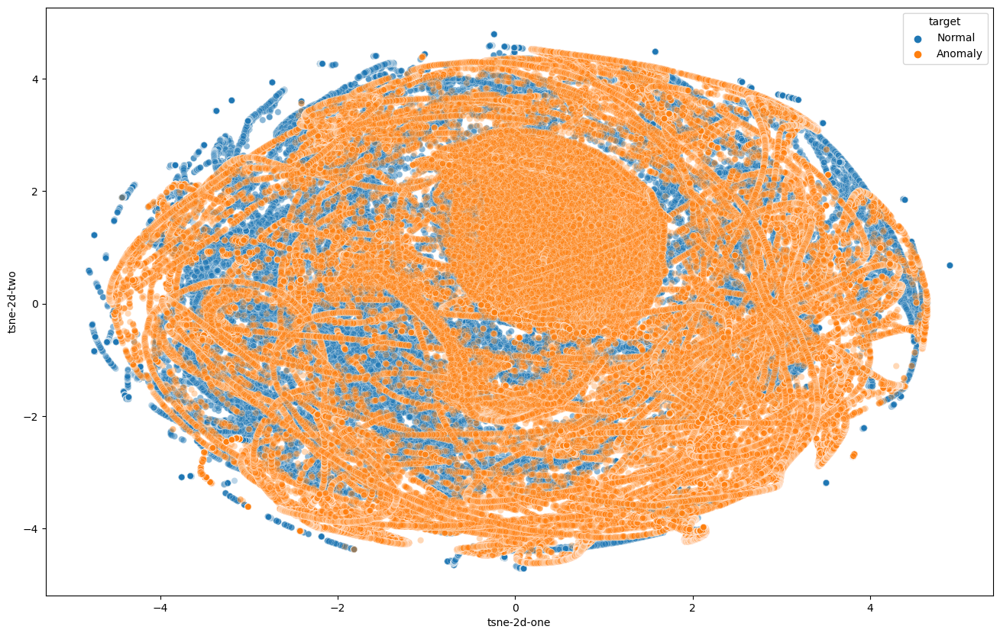

In [144]:
dataF=pd.read_csv('ProposedUpsamplingData.csv')
target1=dataF['target']
feature1=dataF.drop('target',axis=1)
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(feature1)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

feature1['tsne-2d-one'] = tsne_results[:,0]
feature1['tsne-2d-two'] = tsne_results[:,1]

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue=target1,
    data=feature1,
    legend="full",
    alpha=0.3
)

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.016s...
[t-SNE] Computed neighbors for 288688 samples in 4926.245s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 122000 / 288688
[t-SNE] Computed conditional probabilities for sample 123000 / 288688
[t-SNE] Computed conditional probabilities for sample 124000 / 288688
[t-SNE] Computed conditional probabilities for sample 125000 / 288688
[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed conditional probabilities for sample 132000 / 288688
[t-SNE] Computed conditional probabilities for sample 133000 / 288688
[t-SNE] Computed conditional probabilities for sample 134000 / 288688
[t-SNE] Computed conditional probabilities for sample 135000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed conditional probabilities for sample 253000 / 288688
[t-SNE] Computed conditional probabilities for sample 254000 / 288688
[t-SNE] Computed conditional probabilities for sample 255000 / 288688
[t-SNE] Computed conditional probabilities for sample 256000 / 288688
[t-SNE] Computed conditional probabilities for sample 257000 / 288688
[t-SNE] Computed conditional probabilities for sample 258000 / 288688
[t-SNE] Computed conditional probabilities for sample 259000 / 288688
[t-SNE] Computed conditional probabilities for sample 260000 / 288688
[t-SNE] Computed conditional probabilities for sample 261000 / 288688
[t-SNE] Computed conditional probabilities for sample 262000 / 288688
[t-SNE] Computed con

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\3445083758.py:38: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ProposedScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\3445083758.py:38: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ProposedScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\3445083758.py:39: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ProposedScatter.png')
C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


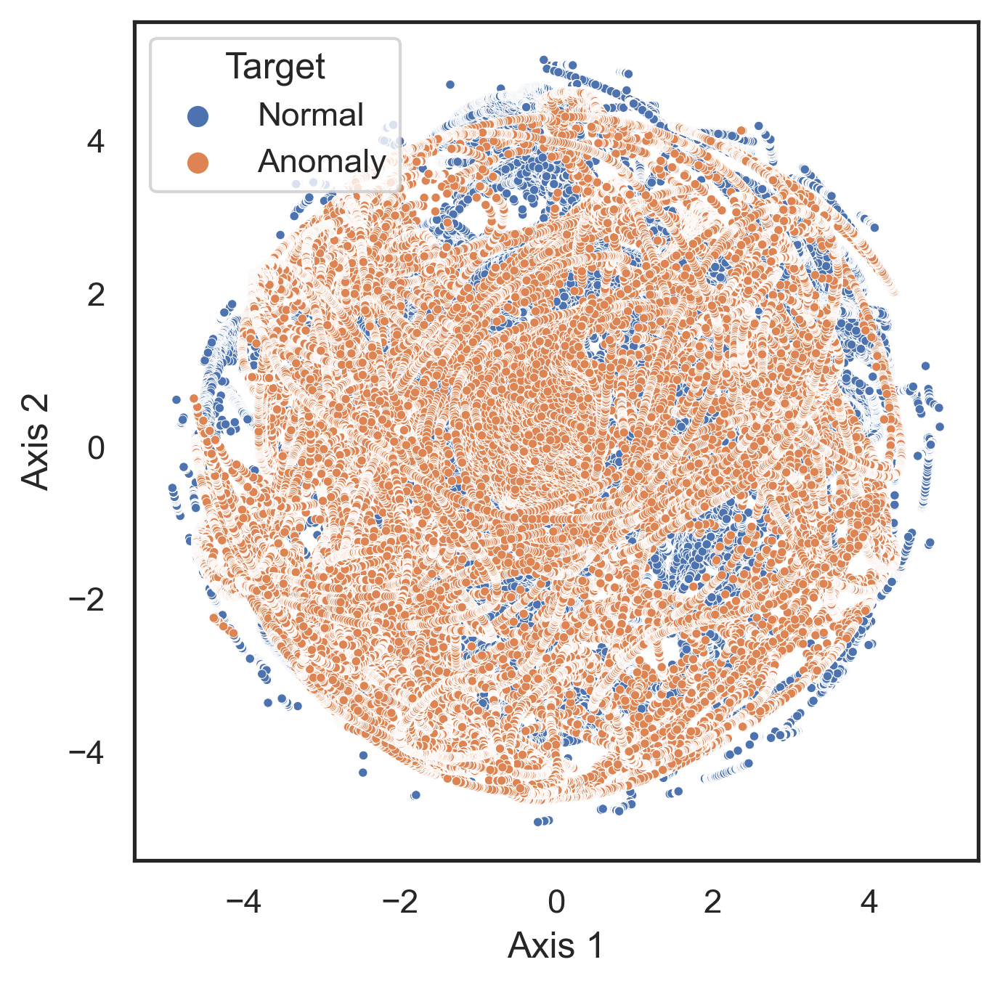

In [358]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

dataF=pd.read_csv('ProposedUpsamplingData.csv')

target1=dataF['target']
feature1=dataF.drop('target',axis=1)

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(feature1)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))



feature1['Axis 1'] = tsne_results[:,0]
feature1['Axis 2'] = tsne_results[:,1]
target1.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=target1,
    data=feature1,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=9
)
plt.savefig('ProposedScatter.pdf')
plt.savefig('ProposedScatter.png')

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.054s...
[t-SNE] Computed neighbors for 288688 samples in 5681.261s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed conditional probabilities for sample 132000 / 288688
[t-SNE] Computed conditional probabilities for sample 133000 / 288688
[t-SNE] Computed conditional probabilities for sample 134000 / 288688
[t-SNE] Computed conditional probabilities for sample 135000 / 288688
[t-SNE] Computed conditional probabilities for sample 136000 / 288688
[t-SNE] Computed conditional probabilities for sample 137000 / 288688
[t-SNE] Computed conditional probabilities for sample 138000 / 288688
[t-SNE] Computed conditional probabilities for sample 139000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 245000 / 288688
[t-SNE] Computed conditional probabilities for sample 246000 / 288688
[t-SNE] Computed conditional probabilities for sample 247000 / 288688
[t-SNE] Computed conditional probabilities for sample 248000 / 288688
[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed conditional probabilities for sample 253000 / 288688
[t-SNE] Computed conditional probabilities for sample 254000 / 288688
[t-SNE] Computed conditional probabilities for sample 255000 / 288688
[t-SNE] Computed conditional probabilities for sample 256000 / 288688
[t-SNE] Computed conditional probabilities for sample 257000 / 288688
[t-SNE] Computed conditional probabilities for sample 258000 / 288688
[t-SNE] Computed con

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2493417384.py:32: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('SMOTEScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2493417384.py:32: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('SMOTEScatter.pdf')
C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


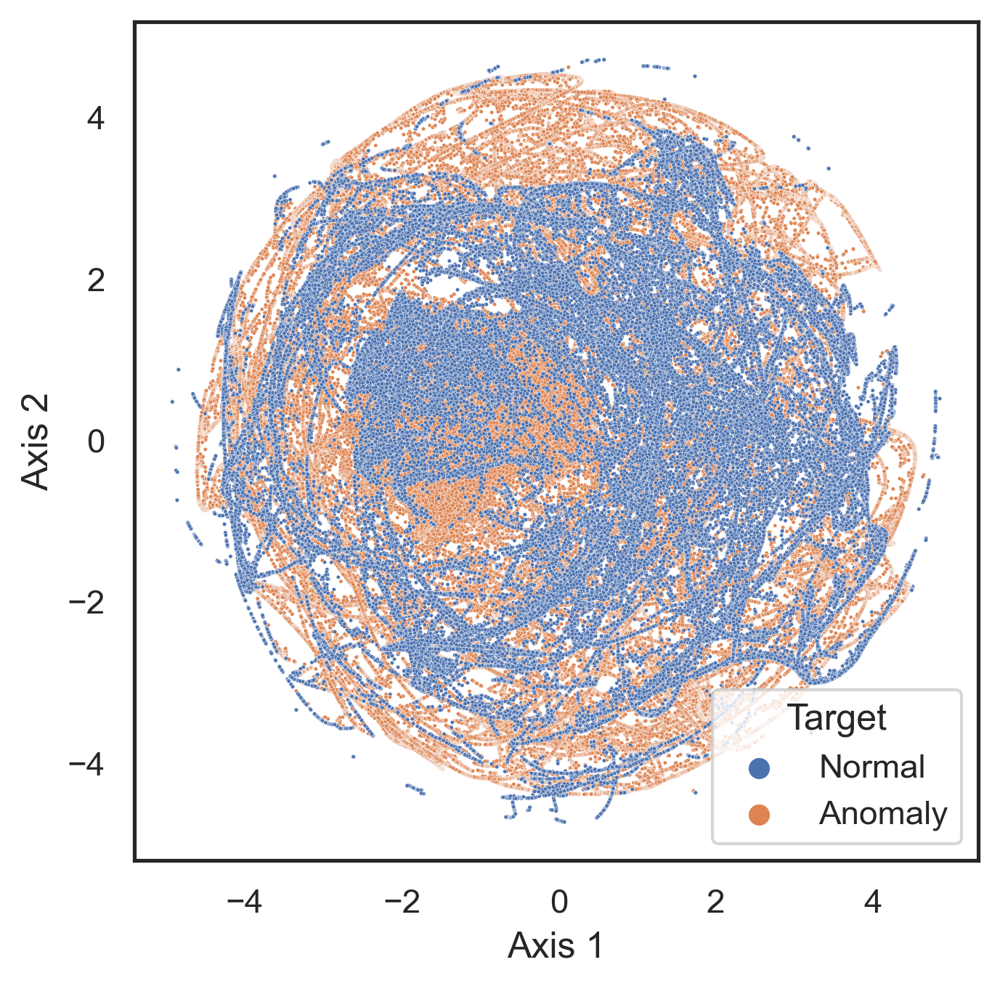

In [347]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_res)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))


X_res['Axis 1'] = tsne_results[:,0]
X_res['Axis 2'] = tsne_results[:,1]
y_res.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=y_res,
    data=X_res,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=1.6
)
plt.savefig('SMOTEScatter.pdf')



C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 287667 samples in 0.021s...
[t-SNE] Computed neighbors for 287667 samples in 4369.082s...
[t-SNE] Computed conditional probabilities for sample 1000 / 287667
[t-SNE] Computed conditional probabilities for sample 2000 / 287667
[t-SNE] Computed conditional probabilities for sample 3000 / 287667
[t-SNE] Computed conditional probabilities for sample 4000 / 287667
[t-SNE] Computed conditional probabilities for sample 5000 / 287667
[t-SNE] Computed conditional probabilities for sample 6000 / 287667
[t-SNE] Computed conditional probabilities for sample 7000 / 287667
[t-SNE] Computed conditional probabilities for sample 8000 / 287667
[t-SNE] Computed conditional probabilities for sample 9000 / 287667
[t-SNE] Computed conditional probabilities for sample 10000 / 287667
[t-SNE] Computed conditional probabilities for sample 11000 / 287667
[t-SNE] Computed conditional probabilities for sample 12000 / 287667
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 120000 / 287667
[t-SNE] Computed conditional probabilities for sample 121000 / 287667
[t-SNE] Computed conditional probabilities for sample 122000 / 287667
[t-SNE] Computed conditional probabilities for sample 123000 / 287667
[t-SNE] Computed conditional probabilities for sample 124000 / 287667
[t-SNE] Computed conditional probabilities for sample 125000 / 287667
[t-SNE] Computed conditional probabilities for sample 126000 / 287667
[t-SNE] Computed conditional probabilities for sample 127000 / 287667
[t-SNE] Computed conditional probabilities for sample 128000 / 287667
[t-SNE] Computed conditional probabilities for sample 129000 / 287667
[t-SNE] Computed conditional probabilities for sample 130000 / 287667
[t-SNE] Computed conditional probabilities for sample 131000 / 287667
[t-SNE] Computed conditional probabilities for sample 132000 / 287667
[t-SNE] Computed conditional probabilities for sample 133000 / 287667
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 246000 / 287667
[t-SNE] Computed conditional probabilities for sample 247000 / 287667
[t-SNE] Computed conditional probabilities for sample 248000 / 287667
[t-SNE] Computed conditional probabilities for sample 249000 / 287667
[t-SNE] Computed conditional probabilities for sample 250000 / 287667
[t-SNE] Computed conditional probabilities for sample 251000 / 287667
[t-SNE] Computed conditional probabilities for sample 252000 / 287667
[t-SNE] Computed conditional probabilities for sample 253000 / 287667
[t-SNE] Computed conditional probabilities for sample 254000 / 287667
[t-SNE] Computed conditional probabilities for sample 255000 / 287667
[t-SNE] Computed conditional probabilities for sample 256000 / 287667
[t-SNE] Computed conditional probabilities for sample 257000 / 287667
[t-SNE] Computed conditional probabilities for sample 258000 / 287667
[t-SNE] Computed conditional probabilities for sample 259000 / 287667
[t-SNE] Computed con

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\109965014.py:31: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ADASYNScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\109965014.py:31: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ADASYNScatter.pdf')
C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


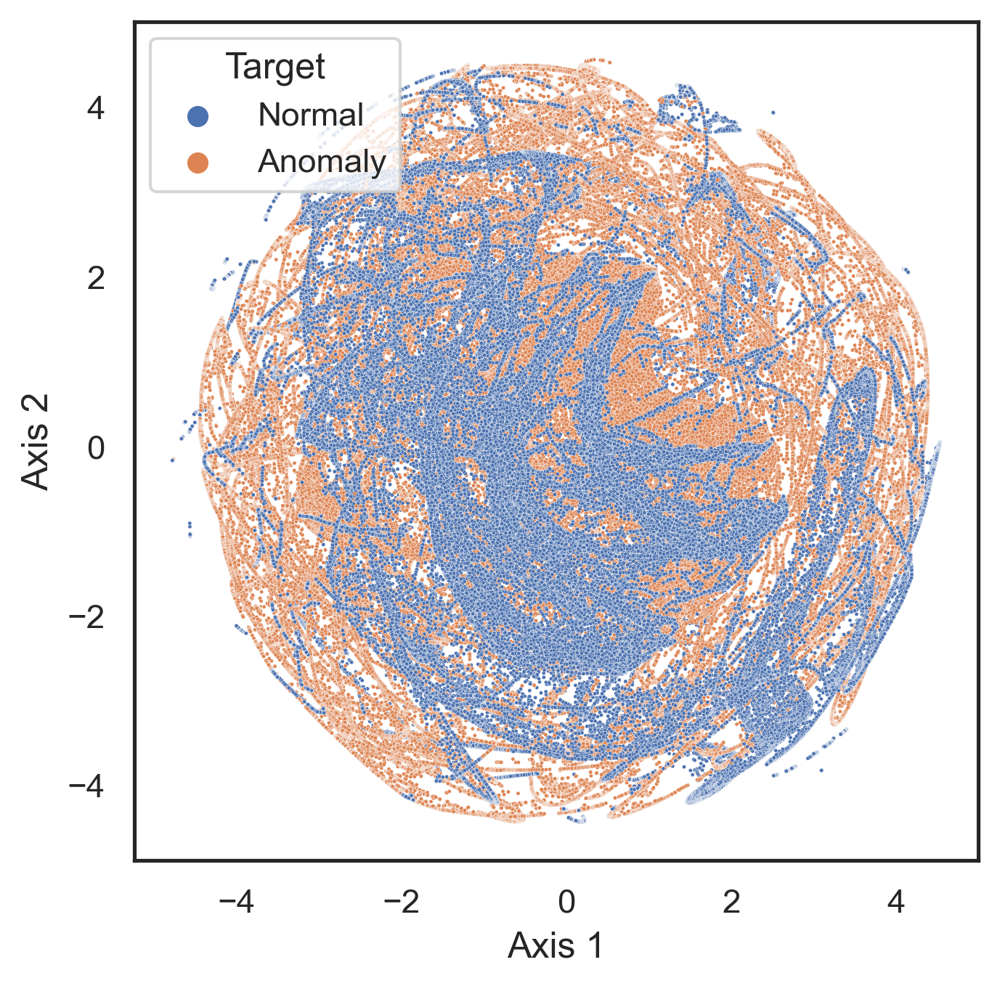

In [346]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_resA)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

X_resA['Axis 1'] = tsne_results[:,0]
X_resA['Axis 2'] = tsne_results[:,1]
y_resY.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=y_resY,
    data=X_resA,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=1.6
)
plt.savefig('ADASYNScatter.pdf')

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.085s...
[t-SNE] Computed neighbors for 288688 samples in 12627.813s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pr

[t-SNE] Computed conditional probabilities for sample 118000 / 288688
[t-SNE] Computed conditional probabilities for sample 119000 / 288688
[t-SNE] Computed conditional probabilities for sample 120000 / 288688
[t-SNE] Computed conditional probabilities for sample 121000 / 288688
[t-SNE] Computed conditional probabilities for sample 122000 / 288688
[t-SNE] Computed conditional probabilities for sample 123000 / 288688
[t-SNE] Computed conditional probabilities for sample 124000 / 288688
[t-SNE] Computed conditional probabilities for sample 125000 / 288688
[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 239000 / 288688
[t-SNE] Computed conditional probabilities for sample 240000 / 288688
[t-SNE] Computed conditional probabilities for sample 241000 / 288688
[t-SNE] Computed conditional probabilities for sample 242000 / 288688
[t-SNE] Computed conditional probabilities for sample 243000 / 288688
[t-SNE] Computed conditional probabilities for sample 244000 / 288688
[t-SNE] Computed conditional probabilities for sample 245000 / 288688
[t-SNE] Computed conditional probabilities for sample 246000 / 288688
[t-SNE] Computed conditional probabilities for sample 247000 / 288688
[t-SNE] Computed conditional probabilities for sample 248000 / 288688
[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed con

<AxesSubplot:xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


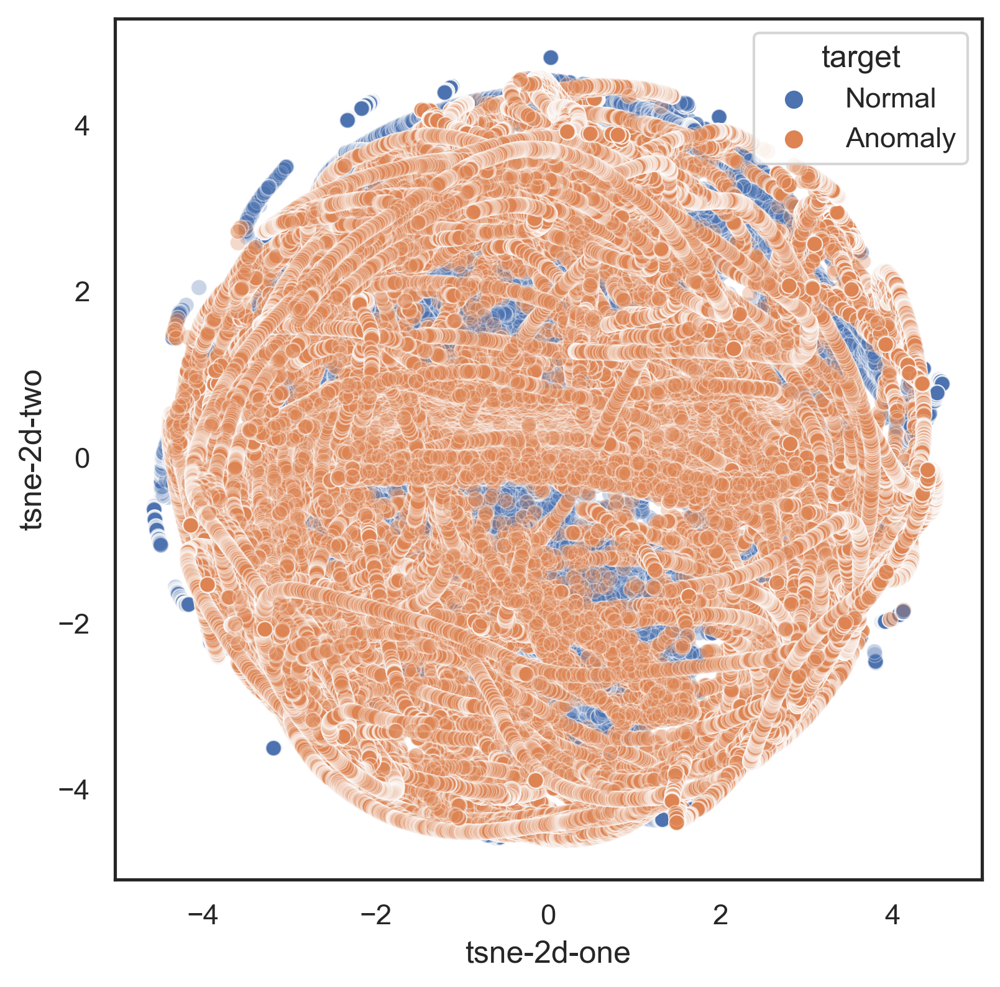

In [325]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(ctganFeature)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))
ctganFeature['Axis 1'] = tsne_results[:,0]
ctganFeature['Axis 2'] = tsne_results[:,1]
ctgantarget.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=ctgantarget,
    data=ctganFeature,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=1.6
)
plt.savefig('ctganScatter.pdf')


In [45]:
def conf_matrix(an, title):
    fig, ax =plt.subplots(figsize=(6,6))
    labels=['Anomaly', 'Normal']
    ax=sns.heatmap(an, annot=True, cmap="Blues", fmt='g', cbar=False, annot_kws={"size":25})
    plt.title(title, fontsize=20)
    ax.xaxis.set_ticklabels(labels, fontsize=17) 
    ax.yaxis.set_ticklabels(labels, fontsize=17)
    ax.set_ylabel('Test', fontsize=20)
    ax.set_xlabel('Predicted', fontsize=20)
    plt.savefig('conIMBALANCED.pdf')

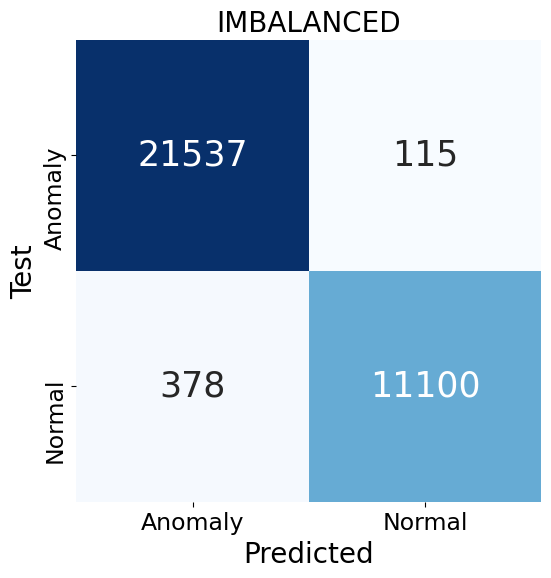

In [48]:
array6 = [[21537  , 115],
 [  378, 11100]]
conf_matrix(array6, 'IMBALANCED')

In [6]:
TP=21537            
TN=11100   
FP=115
FN=378    


print((TP+TN)/(TP+TN+FP+FN))
p=(TP)/(TP+FP)
print(p)
r=(TP)/(TP+FN)
print(r)

print(2*(p*r)/(p+r))

0.9851192272864473
0.9946887123591354
0.9827515400410678
0.9886840957605527


In [21]:
TP=21519            
TN=21362   
FP=133
FN=290    


print((TP+TN)/(TP+TN+FP+FN))
p=(TP)/(TP+FP)
print(p)
r=(TP)/(TP+FN)
print(r)

print(2*(p*r)/(p+r))

0.9902318492518012
0.9938573803805653
0.98670273740199
0.990267136053013


In [24]:
# Python program to demonstrate how to
# perform two sample T-test

# Import the library
import scipy.stats as stats

# Creating data groups
data_group1 = np.array([ 0.990, 0.993,  0.986, 0.990])

data_group2 = np.array([0.991, 0.992, 0.990,0.991])



In [25]:
# t-test for independent samples
from math import sqrt
from numpy.random import seed
from numpy.random import randn
from numpy import mean
from scipy.stats import sem
from scipy.stats import t

# function for calculating the t-test for two independent samples
def independent_ttest(data1, data2, alpha):
	# calculate means
	mean1, mean2 = mean(data1), mean(data2)
	# calculate standard errors
	se1, se2 = sem(data1), sem(data2)
	# standard error on the difference between the samples
	sed = sqrt(se1**2.0 + se2**2.0)
	# calculate the t statistic
	t_stat = (mean1 - mean2) / sed
	# degrees of freedom
	df = len(data1) + len(data2) - 2
	# calculate the critical value
	cv = t.ppf(1.0 - alpha, df)
	# calculate the p-value
	p = (1.0 - t.cdf(abs(t_stat), df)) * 2.0
	# return everything
	return t_stat, df, cv, p

# seed the random number generator
seed(1)
# generate two independent samples
data1 = np.array([ 0.990, 0.993,  0.986, 0.990])
data2 = np.array([ 0.990, 0.993,  0.986, 0.990])
# calculate the t test
alpha = 0.5
t_stat, df, cv, p = independent_ttest(data1, data2, alpha)
print('t=%.3f, df=%d, cv=%.3f, p=%.3f' % (t_stat, df, cv, p))
# interpret via critical value
if abs(t_stat) <= cv:
	print('Accept null hypothesis that the means are equal.')
else:
	print('Reject the null hypothesis that the means are equal.')
# interpret via p-value
if p > alpha:
	print('Accept null hypothesis that the means are equal.')
else:
	print('Reject the null hypothesis that the means are equal.')

t=-0.837, df=6, cv=0.000, p=0.435
Reject the null hypothesis that the means are equal.
Reject the null hypothesis that the means are equal.


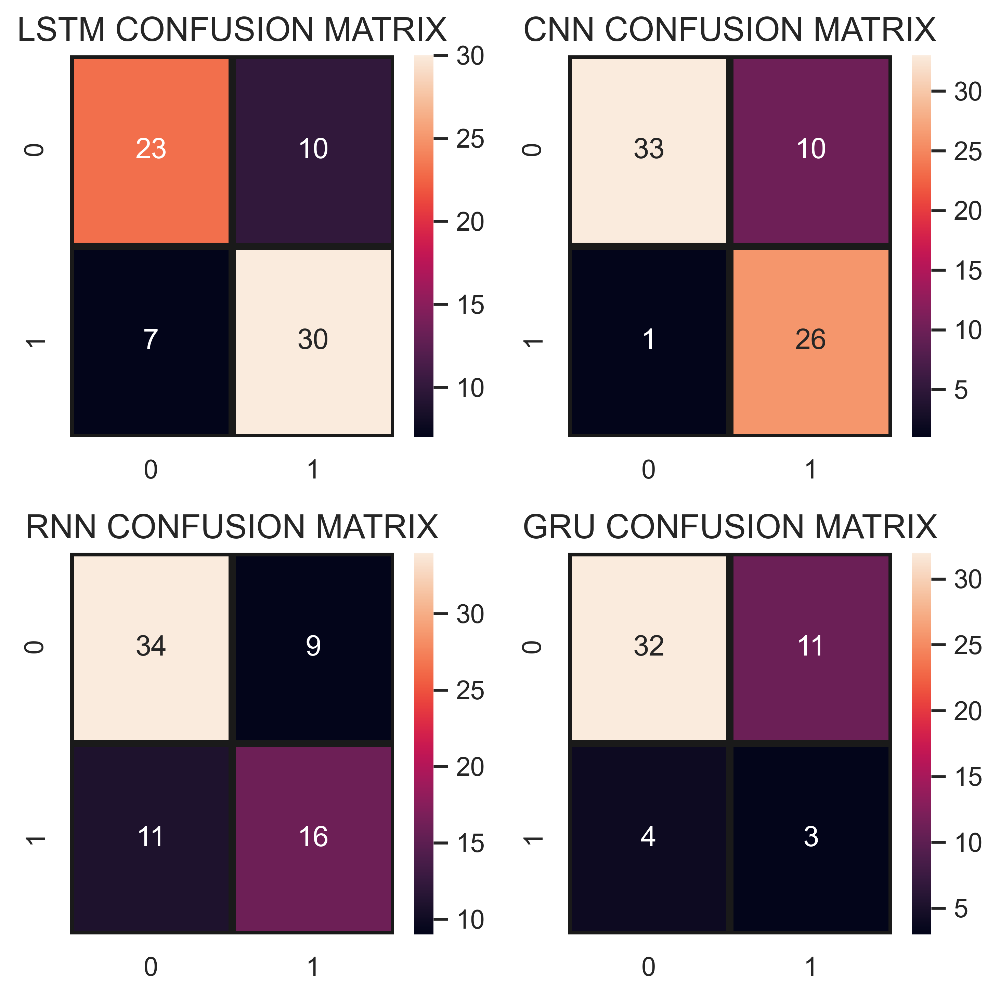

In [212]:
import seaborn as sns
import pandas as pd
array = [[23,10],[7,30]]
LSTM = pd.DataFrame(array, index = [i for i in "01"],
                  columns = [i for i in "01"])

array1 = [[33,10],[1,26]]
CNN = pd.DataFrame(array1, index = [i for i in "01"],
                  columns = [i for i in "01"])
array2 = [[34,9],[11,16]]
RNN = pd.DataFrame(array2, index = [i for i in "01"],
                  columns = [i for i in "01"])
array3 = [[32,11],[4,3]]
GRU = pd.DataFrame(array3, index = [i for i in "01"],
                  columns = [i for i in "01"])

i=1
def plot_sub_sentiment(Airline,A):
    sns.set()
    #tmp = rfc.fit(X_train, y_train.ravel())
    sns.heatmap(Airline,annot=True,fmt = "d",linecolor="k",linewidths=3)
    plt.title(A +" CONFUSION MATRIX",fontsize=14)

plt.figure(1,figsize=(6,6),dpi=500)
plt.subplot(221) 
plot_sub_sentiment(LSTM,'LSTM')
plt.subplot(222)
plot_sub_sentiment(CNN,'CNN')
plt.subplot(223)
plot_sub_sentiment(RNN,'RNN')
plt.subplot(224)
plot_sub_sentiment(GRU,'GRU')


plt.tight_layout()
plt.savefig('Before.png')

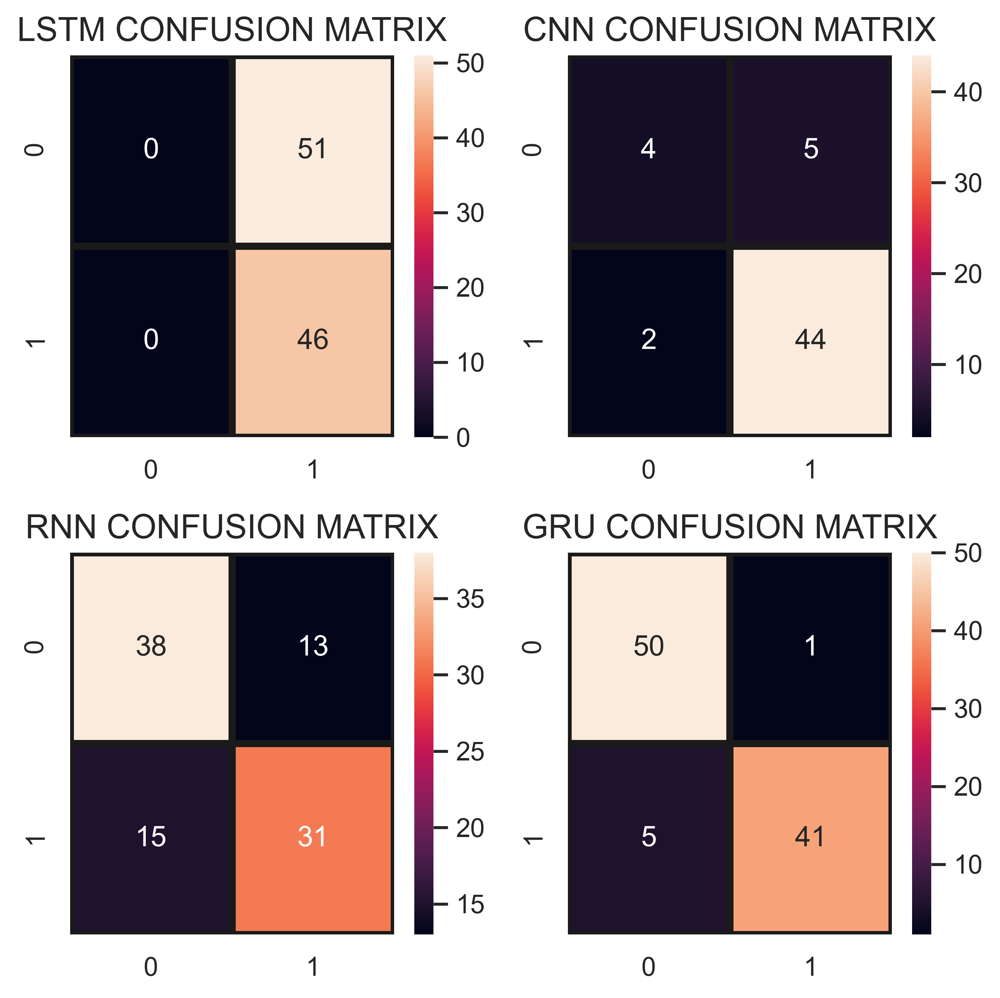

In [213]:
import seaborn as sns
import pandas as pd
array = [[0,51],[0,46]]
LSTM = pd.DataFrame(array, index = [i for i in "01"],
                  columns = [i for i in "01"])

array1 = [[4,5],[2,44]]
CNN = pd.DataFrame(array1, index = [i for i in "01"],
                  columns = [i for i in "01"])
array2 = [[38,13],[15,31]]
RNN = pd.DataFrame(array2, index = [i for i in "01"],
                  columns = [i for i in "01"])
array3 = [[50,1],[5,41]]
GRU = pd.DataFrame(array3, index = [i for i in "01"],
                  columns = [i for i in "01"])

i=1
def plot_sub_sentiment(Airline,A):
    sns.set()
    #tmp = rfc.fit(X_train, y_train.ravel())
    sns.heatmap(Airline,annot=True,fmt = "d",linecolor="k",linewidths=3)
    plt.title(A +" CONFUSION MATRIX",fontsize=14)

plt.figure(1,figsize=(6, 6),dpi=500)
plt.subplot(221) 
plot_sub_sentiment(LSTM,'LSTM')
plt.subplot(222)
plot_sub_sentiment(CNN,'CNN')
plt.subplot(223)
plot_sub_sentiment(RNN,'RNN')
plt.subplot(224)
plot_sub_sentiment(GRU,'GRU')


plt.tight_layout()
plt.savefig('after.png')